# Important, to correctly see the graphs and the map of this notebook, click on this link : https://nbviewer.jupyter.org/github/agpmilli/network-tour-so/blob/master/StackOverflow.ipynb
# EE-558 - Network tour of Data Science 
## Project: Stack Overflow survey network analysis

### Authors
Romain Choukroun, Matthias Leroy, Alain Milliet, Hector Parmantier

### Question

What's the best developer job like ? (depending on your own definition
of "best")

### Dataset

We used the dataset provided by [StackOverflow on
Kaggle](https://www.kaggle.com/stackoverflow/so-survey-2017/data), you can download it and directly run the notebook. It contains about fifty thousand answers from a
sample of the active StackOverflow population about a lot of questions,
namely 154. This means that we have a tremendous insight into what
makes a programmer unique, but we also can answer a lot of
interesting questions.

### Project

#### Exploratory

Check the distributions of all useful features, outliers, quantiles.
Questions we could answer with the exploration:

-   What features are more correlated with satisfaction?
        Does salary equates to happiness/fulfilment in your job ?
        How much is Job Satisfaction linked to education ?
        Are "gif" people more satisfied with their job compared to "jif" people ?

-   What does the population that answered to this survey looks like ?
-   Can we find what are the most used programming languages in the StackOverflow population ?
    
#### Metric
Derive a metric to measure the distance inbetween users

#### Pre-processing

Data cleaning, categorize values, check out their distribution,
selecting columns, removing bad values if needed.

#### Graph Analysis

The graph will be built the following way:

-   Users will be the nodes

-   Correlations (with a threshold) in-between users used as edges

#### Recommender System

The idea of the recommender system is to be able to recommend users
to recruiters. To do so, we would simply check
which existing node is the closest to the artificial one that we create
for the chosen features a recruiter is looking for.



In [1]:
# Importing a few utilities
%config InlineBackend.figure_format = 'retina'
from helper_functions import *
from plotly import tools
from plotly.offline import iplot, init_notebook_mode
from scipy.stats import ks_2samp
from subprocess import check_output
import colorlover as cl
import matplotlib.pyplot as plt
import numpy as np 
import pandas as pd
import plotly.plotly as py
import plotly.graph_objs as go
import seaborn as sns
import networkx as nx
import warnings
init_notebook_mode()
warnings.filterwarnings('ignore')

In [2]:
# Let's import the data
stack = pd.read_csv("data/survey_results_public.csv")

# We only keep the following columns 
# for the analysis and the recommender system
kept_columns = ['Respondent', 'Professional', 'ProgramHobby', 'Country', 'University', 'EmploymentStatus', 'FormalEducation', 'MajorUndergrad', 'CompanySize', 'CompanyType', 'YearsProgram', 'YearsCodedJob', 'DeveloperType', 'WebDeveloperType', 'NonDeveloperType', 'CareerSatisfaction', 'JobSatisfaction', 'PronounceGIF', 'ProblemSolving', 'BuildingThings', 'LearningNewTech', 'BoringDetails', 'JobSecurity', 'DiversityImportant', 'FriendsDevelopers', 'WorkPayCare', 'ChallengeMyself', 'ImportantBenefits', 'ClickyKeys', 'Overpaid', 'TabsSpaces', 'EducationImportant', 'EducationTypes', 'SelfTaughtTypes', 'WorkStart', 'HaveWorkedLanguage', 'WantWorkLanguage', 'IDE', 'AuditoryEnvironment', 'Methodology', 'EquipmentSatisfiedMonitors', 'StackOverflowSatisfaction', 'StackOverflowFoundAnswer', 'StackOverflowCopiedCode', 'StackOverflowWhatDo', 'Gender', 'HighestEducationParents', 'Race', 'Salary', "ExpectedSalary"]
stack = stack[kept_columns]
stack.set_index("Respondent", inplace=True)
stack.head()

,Professional,ProgramHobby,Country,University,EmploymentStatus,FormalEducation,MajorUndergrad,CompanySize,CompanyType,YearsProgram,...,EquipmentSatisfiedMonitors,StackOverflowSatisfaction,StackOverflowFoundAnswer,StackOverflowCopiedCode,StackOverflowWhatDo,Gender,HighestEducationParents,Race,Salary,ExpectedSalary
Respondent,,,,,,,,,,,,,,,,,,,,,
1,Student,"Yes, both",United States,No,"Not employed, and not looking for work",Secondary school,NaN,NaN,NaN,2 to 3 years,...,Somewhat satisfied,9.0,At least once each week,Haven't done at all,Strongly agree,Male,High school,White or of European descent,NaN,NaN
2,Student,"Yes, both",United Kingdom,"Yes, full-time",Employed part-time,Some college/university study without earning ...,Computer science or software engineering,20 to 99 employees,"Privately-held limited company, not in startup...",9 to 10 years,...,Not very satisfied,8.0,Several times,Several times,Strongly agree,Male,A master's degree,White or of European descent,NaN,37500.0
3,Professional developer,"Yes, both",United Kingdom,No,Employed full-time,Bachelor's degree,Computer science or software engineering,"10,000 or more employees",Publicly-traded corporation,20 or more years,...,Very satisfied,8.0,Once or twice,Haven't done at all,Agree,Male,A professional degree,White or of European descent,113750.0,NaN
4,Professional non-developer who sometimes write...,"Yes, both",United States,No,Employed full-time,Doctoral degree,A non-computer-focused engineering discipline,"10,000 or more employees",Non-profit/non-governmental organization or pr...,14 to 15 years,...,NaN,10.0,At least once each week,Several times,Strongly agree,Male,A doctoral degree,White or of European descent,NaN,NaN
5,Professional developer,"Yes, I program as a hobby",Switzerland,No,Employed full-time,Master's degree,Computer science or software engineering,10 to 19 employees,"Privately-held limited company, not in startup...",20 or more years,...,Satisfied,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [3]:
# Splitting the dataframe into 
# students and professionals
stack = stack[stack.apply(lambda row: row_filter(stack,row), axis=1)]
prof_stack = stack[stack.Professional == "Professional developer"]
stud_stack = stack[stack.Professional == "Student"]

metadata = pd.read_csv("data/survey_results_schema.csv")
metadata.head()

,Column,Question
0,Respondent,Respondent ID number
1,Professional,Which of the following best describes you?
2,ProgramHobby,Do you program as a hobby or contribute to ope...
3,Country,In which country do you currently live?
4,University,"Are you currently enrolled in a formal, degree..."


# Exploratory Analysis

In this section we will explore different columns of our dataframe to have an idea of what the population we have looks like. We decided to split the professionals and the students such that we can obtain 2 different recommender systems in function of what the recruiter is looking for. For certain features, it makes sense to compare the professionals and the students but for some others it makes more sense to do some statistics on the whole data.

## Professional
In this subsection we want to see the proportion of professionals and students we have in our data

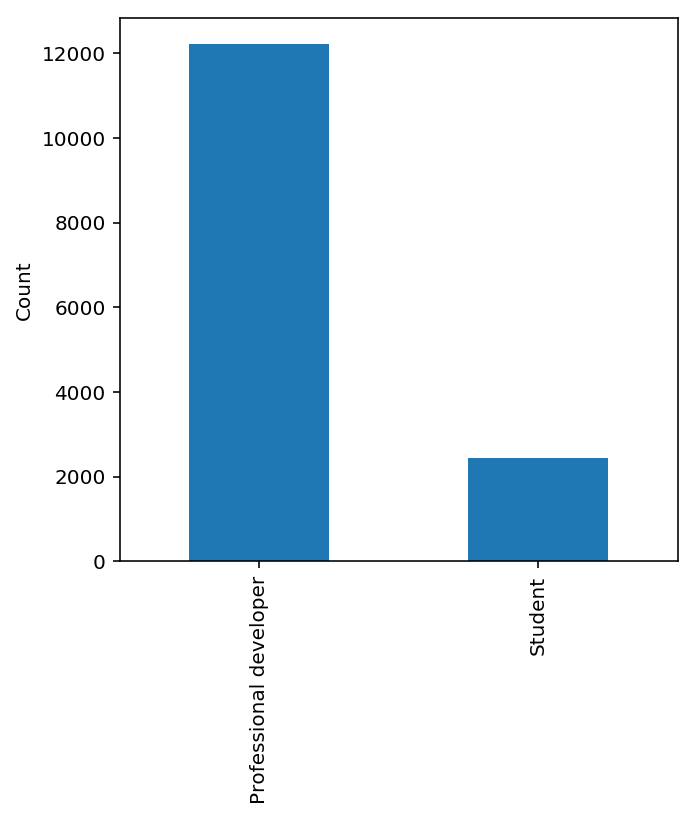

In [4]:
stack['Professional'].value_counts()[0:10].plot(kind='bar',figsize=(5,5))
plt.ylabel("Count")
plt.show()

On this graph, we can see the proportion of professionals and students in our dataset. As we can see, there are a lot more professionals than students.

## Country
We wanted to know from what country the people that answered to the survey come. As we have more professionals than students, we decided to take the 10 countries with the biggest number of professionals and from there we mapped the number of students for thes countries. 

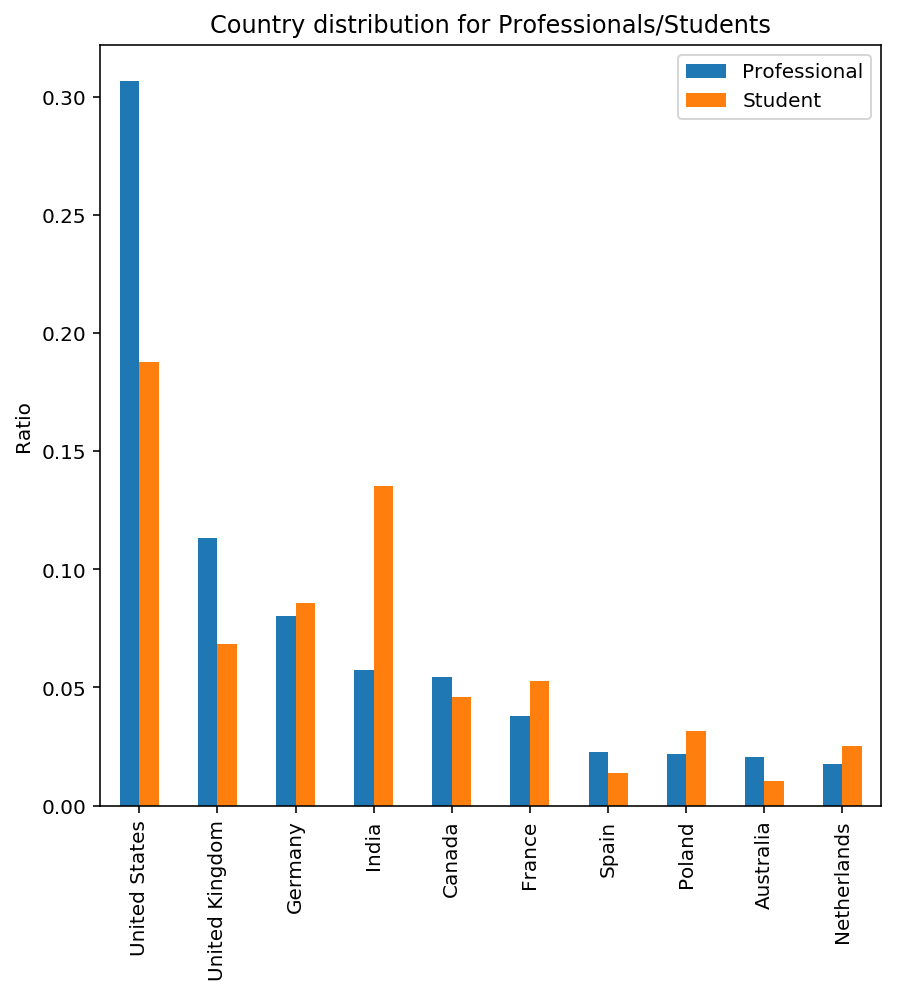

In [5]:
plot_stud_prof(prof_stack=prof_stack, stud_stack=stud_stack, column='Country', title="Country")

On this graph, we can see that the percentage of professionals is not always proportional to the percentage of students in the same country. The United States and India are the two most obvious ones. While 30% of professionals come from the USA, less than 20% of the students come from there. On the other hand, only 5% of professionals in our data come from India while nearly 15% of students come from there.

## Developer Type
This subsection concerns the type of developer we can find in our dataset. 

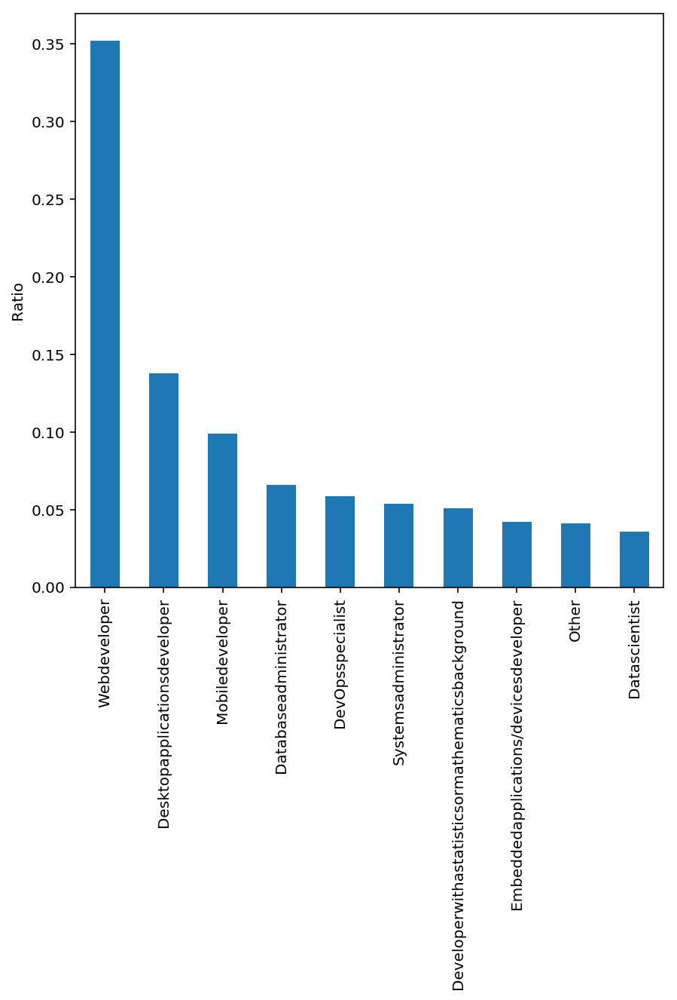

In [6]:
DevTypes = pd.Series([devtype for sublist in [str(devtypes).replace(" ", "").split(";") for devtypes in stack['DeveloperType'].dropna()] for devtype in sublist])
DevTypes.value_counts(normalize=True)[0:10].plot(kind='bar',figsize=(7,7))
plt.ylabel("Ratio")
plt.show()

As an observation, we can say that the major part of the population in our dataset define themself as Web Developper. But this result does not give that much information as there are multiple types of Web developpers.

## Languages
As the previous section was about the type of developper we wanted to see if the programming languages correspond to the these types

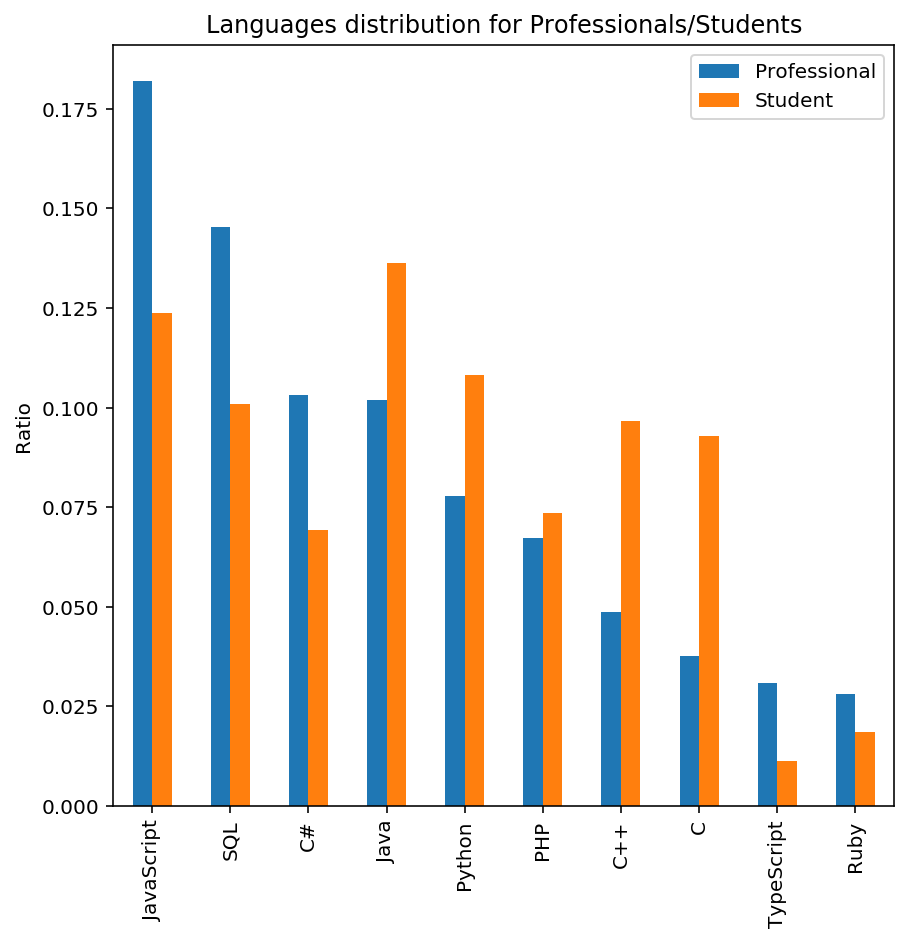

In [7]:
prof_languages = pd.Series([lang for sublist in [str(langs).replace(" ", "").split(";") for langs in prof_stack['HaveWorkedLanguage'].dropna()] for lang in sublist])
stud_languages = pd.Series([lang for sublist in [str(langs).replace(" ", "").split(";") for langs in stud_stack['HaveWorkedLanguage'].dropna()] for lang in sublist])
plot_stud_prof(prof=prof_languages, stud=stud_languages, title="Languages")

It looks like it corresponds pretty well as the most important programming language we find is directly linked to the Web Development. We were interested in knowing what were the most important languages per country, so we decided to plot them on a map.

In [8]:
# We prepare the data for the map
codes = [MAP_COUNTRIES[country] if country != 'I prefer not to say' else None for country in stack['Country']]
stack['Code']=codes

country_stack = stack[['HaveWorkedLanguage','Code']]
country_stack["HaveWorkedLanguage"] = country_stack["HaveWorkedLanguage"].apply(lambda x: str(x).replace(" ", "").split(";"))
country_stack = country_stack.set_index('Code')

language_country = pd.get_dummies(pd.DataFrame(country_stack['HaveWorkedLanguage'].tolist(), index=country_stack.index).stack()).sum(level=0)
language_country = language_country.T.idxmax()
languages = list(language_country.unique())
languages.remove('nan')

# Get a 12 colors scale
paired = cl.scales['12']['qual']['Paired']
# Create dict between language and color
language_color_dict = {}
for i, language in enumerate(languages):
    language_color_dict[language]=paired[i]
# Create dict between language and countries
language_country_dict = {}
for index, row in language_country.iteritems():
    if row in language_country_dict:
        language_country_dict[row].append(index)
    else:
        language_country_dict[row]=[index]

data = []
for i, lang in enumerate(languages):
    trace1 = go.Choropleth(
        z=['1']*len(language_country_dict[lang]),
        autocolorscale=False,
        colorscale=[[0, 'rgb(255,255,255)'], [1, language_color_dict[lang]]],
        hoverinfo='text',
        locations=language_country_dict[lang],
        name=lang,
        showscale=False,
        text=lang
    )
    data.append(trace1)
layout = dict(
    title = 'Most represented programming language per country',
    geo = dict(
            projection = dict(
                type = 'Mercator'
            ),
            showframe=False
            )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig)

We can see on this map the real importance of StackOverflow for Javascript developers around the world.

## Job Satisfaction
In this case, we wanted to see how satisfied of their job the people in our dataset are. We compared the job satisfation with the career satisfaction.

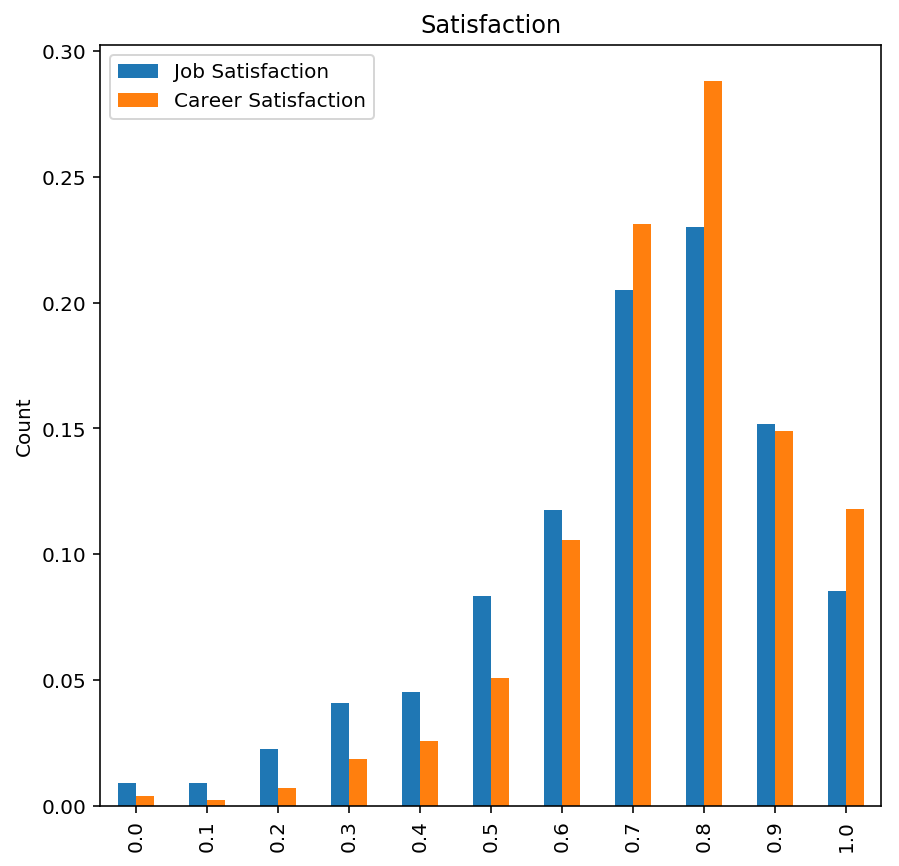

In [9]:
# Let's take a look at the satisfaction of each surveyee
jobSat = stack['JobSatisfaction']/stack['JobSatisfaction'].max()
carrSat = stack['CareerSatisfaction']/stack['CareerSatisfaction'].max()
j_satisfaction = jobSat.value_counts(normalize=True).sort_index()
carr = carrSat.value_counts(normalize=True)
c_satisfaction = carr.loc[j_satisfaction.index]
df = pd.DataFrame([j_satisfaction, c_satisfaction])
df = df.T
df.columns = ["Job Satisfaction", "Career Satisfaction"]
df.plot.bar(figsize=(7,7))
plt.title('Satisfaction')
plt.ylabel("Count")
plt.show()

It is pretty clear on the graph above that the job satisfaction and the career satisfaction are directly linked. To remove all bias such as a person that votes 4 for the job and 8 for the career while another person votes 8 for the job and 4 for the career, we decided to look at the difference between these values and see if we have a lot of people having that much difference between their satisfactions.

In [10]:
satisfaction = stack[['JobSatisfaction','CareerSatisfaction']]
satisfaction['Difference']= np.abs(satisfaction['JobSatisfaction']-satisfaction['CareerSatisfaction'])
satisfaction['Difference'].describe()

count    12210.000000
mean         1.175594
std          1.352746
min          0.000000
25%          0.000000
50%          1.000000
75%          2.000000
max         10.000000
Name: Difference, dtype: float64

As we can see, in general people give approximately the same satisfaction score to their job and to their career. It means that the distribution seen above is correct. Let's now see what causes the developers to be happy or unhappy in their professional life.

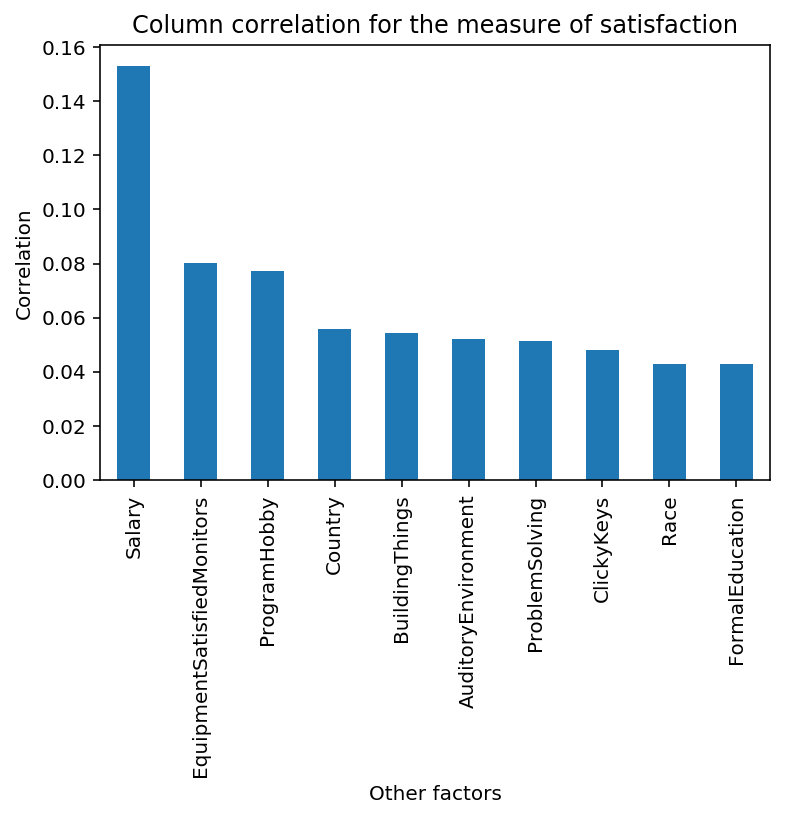

In [11]:
# We keep the columns liked to satisfaction, 
# we mean them together and normalize the result
satisfaction_mean = prof_stack[["JobSatisfaction", "CareerSatisfaction"]].mean(axis=1)
satisfaction_mean = (satisfaction_mean - satisfaction_mean.min()) / (satisfaction_mean.max() - satisfaction_mean.min())

# Separate the other factors
other_factors = prof_stack.drop(["StackOverflowSatisfaction", "CareerSatisfaction", "JobSatisfaction", "ExpectedSalary"], axis=1)
other_factors = other_factors.fillna("")

# In order to measure the correlation we need 
# to encode the labels need to encode the 
# labels to measure the correlation
for c in other_factors.columns:
    le = preprocessing.LabelEncoder()
    le.fit(other_factors[c])
    other_factors[c] = le.transform(other_factors[c])
    
# Which columns does the satisfaction correlate the most with ?
most_satisfactory = other_factors.corrwith(satisfaction_mean).nlargest(10)
most_satisfactory.plot.bar()
plt.ylabel("Correlation")
plt.xlabel("Other factors")
plt.title("Column correlation for the measure of satisfaction")
plt.show()

As expected, we can see that the more people have a high salary, the more satisfied they are. Interestingly, it also correlates with general welness at work, for example the equipment, or the environnement, but also with their free time ! They see to be more happy if they program as a hobby and if they build stuff on their own. Finally, obviously the biggest factors like Country, Education and Race matter a lot too, which was to be expected.

## Diversity Important
In this section we will analyze if professionals and students give the same importance to the diversity at their job.

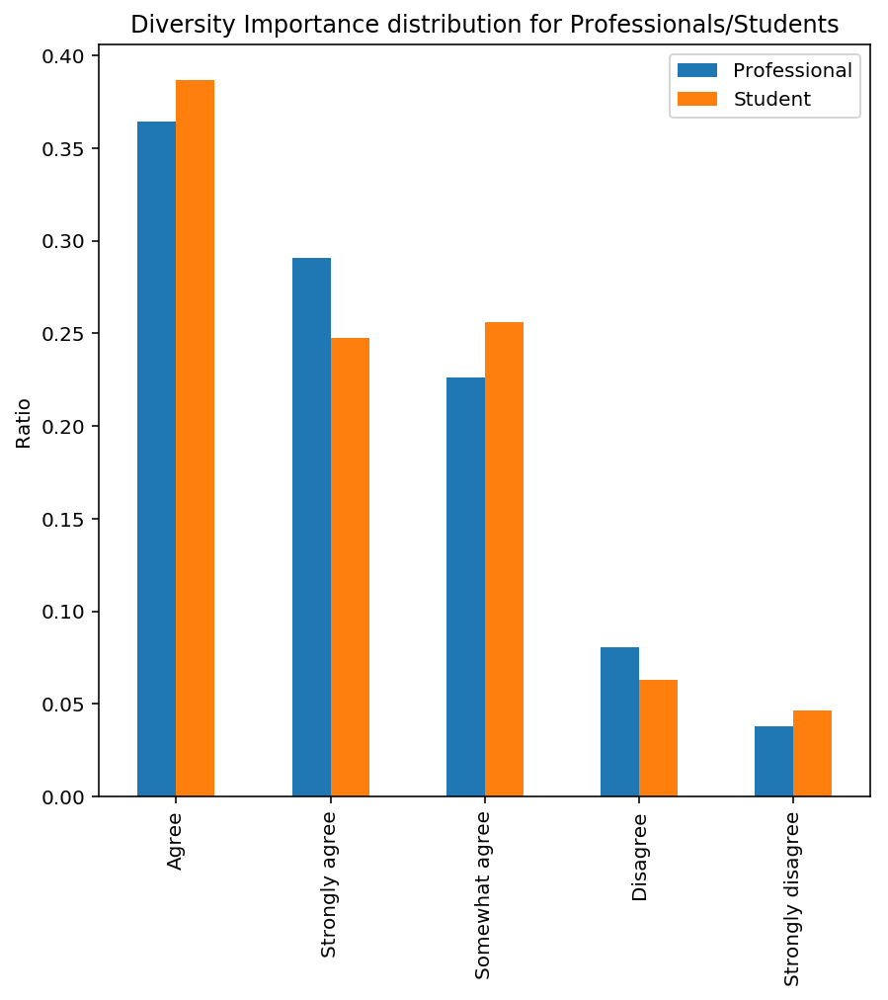

In [12]:
plot_stud_prof(prof_stack=prof_stack, stud_stack=stud_stack, column='DiversityImportant', title="Diversity Importance")

We can pretty easily see that the two distributions are really close and it seems to not be different between professionals and students

## Salaries
Let's take a look at how the salaries compare for the whole dataset

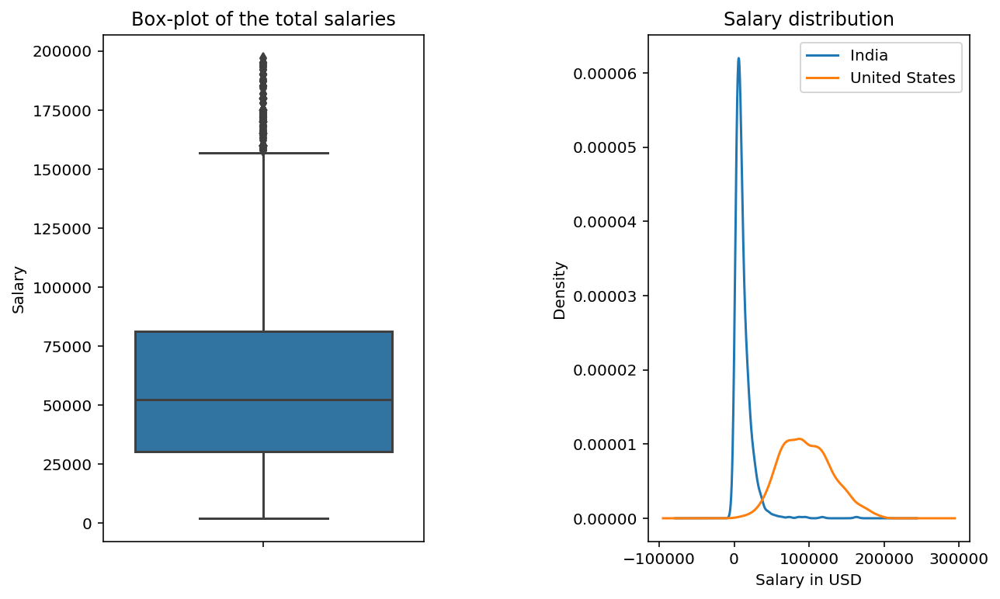

In [13]:
f, (box, dist) = plt.subplots(nrows=1, ncols=2, figsize=(10,6))
f.subplots_adjust(wspace=0.7)

# Boxplot of the salaries
sns.boxplot(prof_stack.Salary, orient='v', ax=box)
box.set_title("Box-plot of the total salaries")

# Comparing India and the USA salary-wise
usa_salary = prof_stack[prof_stack.Country == "United States"].Salary
usa_salary.rename("United States", inplace=True)
india_salary = prof_stack[prof_stack.Country == "India"].Salary
india_salary.rename("India", inplace=True)
india_salary.plot.kde(legend=True, ax=dist)
usa_salary.plot.kde(legend=True, ax=dist)
dist.set_title("Salary distribution")
dist.set_xlabel("Salary in USD")
plt.show()

As expected, the boxplot shows that we have a high breadth of salaries. If we compare the distribution of two different countries, we can see why, each country simply have their own revenue model for the profession. What about the students, do they their salary expectation meet the reality or not ?

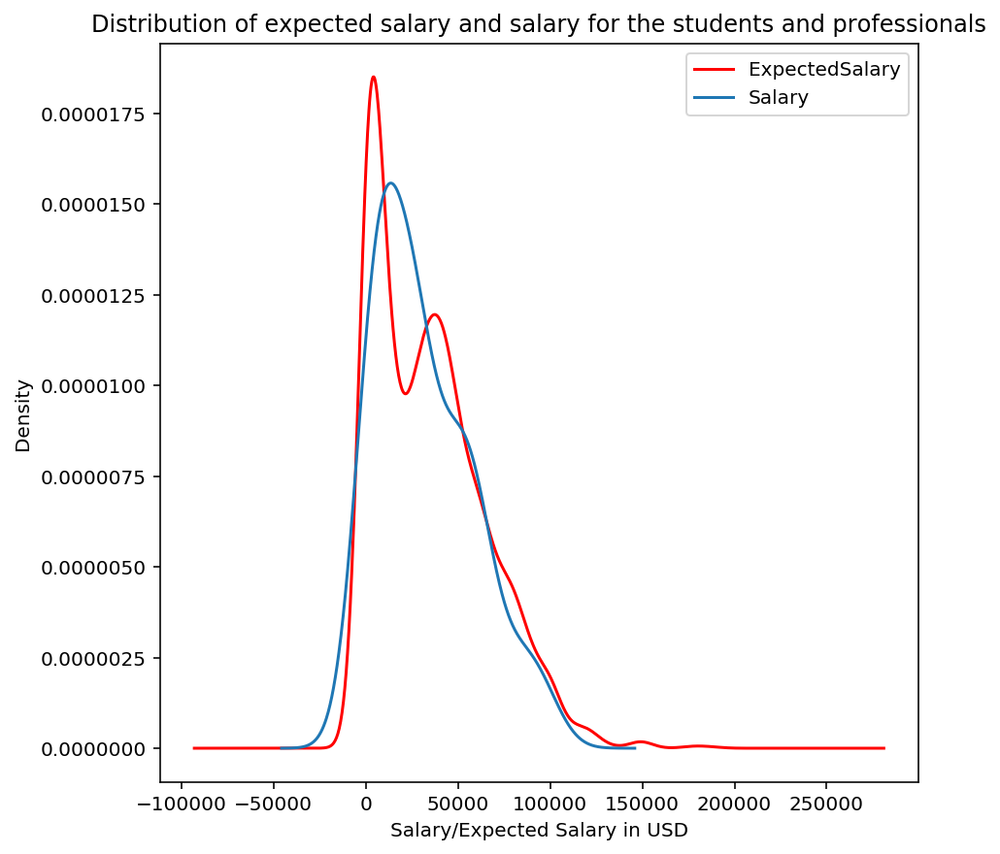

In [14]:
# We compare the student expectations to the young professionals
stud_stack.ExpectedSalary.plot(kind='kde', figsize=(10,8), color='r', legend=True)
prof_stack[(prof_stack.YearsProgram == "Less than a year")].Salary.plot(kind='kde', figsize=(7,7), legend=True)
plt.xlabel("Salary/Expected Salary in USD")
plt.title("Distribution of expected salary and salary for the students and professionals")
plt.show()

Indeed, they match quite nicely ! Students are not the highest dreamers after all.

Another really important aspect concerning the salary is the equality inbetween women and men. Let's verify that it holds for the StackOverflow community.

In [15]:
female_salary = stack[stack.Gender == "Female"].Salary
male_salary = stack[stack.Gender == "Male"].Salary
male_salary.rename("Male", inplace=True)
female_salary.rename("Female", inplace=True)
print("There are {} male samples and {} female samples.".format(male_salary.count(), female_salary.count()))

There are 10185 male samples and 772 female samples.


As we can see the samples are really unequal, so it would be unwise to try and draw any conclusions as the salaries are supposedly quite close to one another. We decided instead to take it very seriously and run a pairwise-matching to find a one to one mapping of each woman to a man, without taking into account the salary, and then check the distributions. This way the comparisons will make sense.

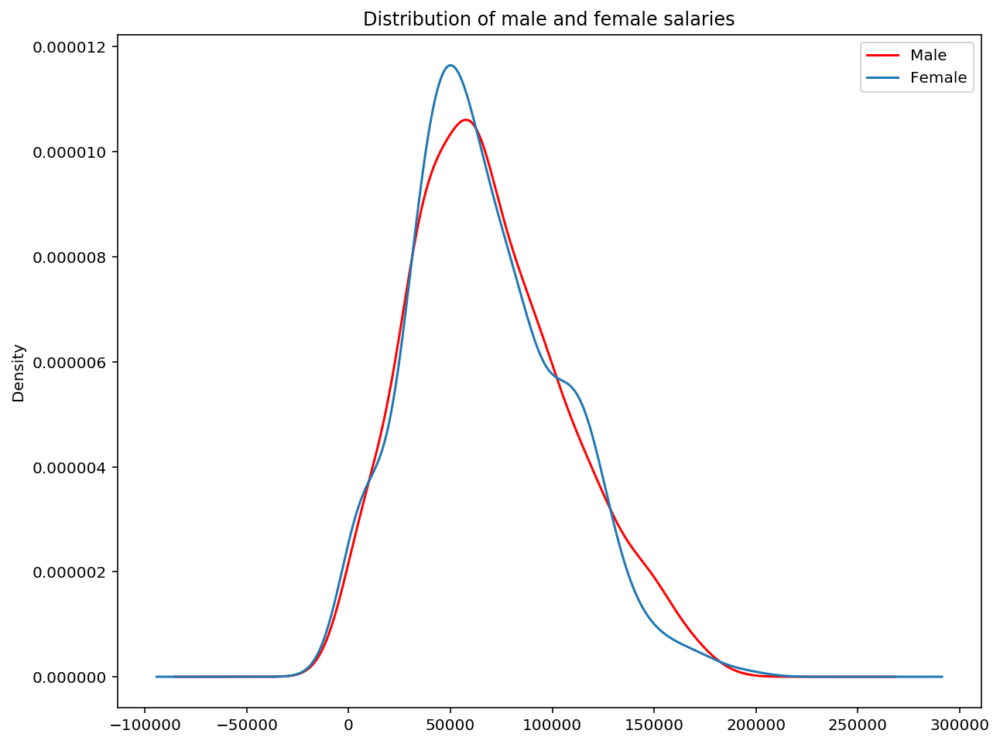

We get a statistic of 0.0694 and a p_value of 0.2243 for 447 male samples and 447 female samples.

The male salaries quartiles:
count       447.000000
mean      69175.538832
std       37966.394086
min        3167.420814
25%       40148.148148
50%       63000.000000
75%       94750.000000
max      180000.000000
Name: Male, dtype: float64

The female salaries quartiles:
count       447.000000
mean      66928.530548
std       36700.283859
min        2150.537634
25%       41770.833333
50%       60000.000000
75%       90000.000000
max      195000.000000
Name: Female, dtype: float64


In [16]:
# We select the columns to use as features
similarity_features = ['Country', 'University',
       'EmploymentStatus', 'FormalEducation', 'CompanySize',
       'CompanyType', 'YearsCodedJob', 'DeveloperType',
       'WebDeveloperType', 'NonDeveloperType',
       'EducationTypes', 'HaveWorkedLanguage', 'Methodology',
       'HighestEducationParents', 'Race']

# The following columns we want a 1 to 1 matching for
# as they are the most important features
perfect_matches = ['Country', 'EmploymentStatus', 'FormalEducation', 
                   'YearsCodedJob','HighestEducationParents', 'Race']

sim_stack = prof_stack[similarity_features].copy()
to_dummy = ["HaveWorkedLanguage", "DeveloperType", "Methodology", "EducationTypes", "NonDeveloperType", "Race"]
for sub in to_dummy:
    sim_stack[sub] = sim_stack[sub].apply(lambda x: str(x).replace(" ", "").split(";"))
    if sub == "Race":
        sim_stack[sub] = sim_stack[sub].apply(lambda x: ["Race_" + s for s in x])
    sim_stack = pd.concat([sim_stack, pd.get_dummies(pd.DataFrame(sim_stack[sub].tolist(), index=sim_stack.index).stack()).sum(level=0)], axis=1).drop(sub, axis=1)

# Final dummies we will be using
dummied_prof = pd.get_dummies(sim_stack)
dum_female = dummied_prof[prof_stack.Gender == "Female"]
dum_male = dummied_prof[prof_stack.Gender == "Male"]

# We load the data from a pickle for
# speed otherwise, change the constant
load_from_pickle = False
matching = pd.DataFrame(index=dum_female.index, columns=["male_matched", "correlation"])
for i,fem in enumerate(matching.index):
    print("Progress: {:.2f}%".format((i+1)/matching.shape[0]*100), end="\r")
    # We match the following female
    female_to_match = dum_female.loc[fem]

    # We want an exact match for the 
    # specified columns in the previous cell
    perfect_columns = [col for c in perfect_matches for col in dum_male if col.startswith(c) ]
    male_possibilities = dum_male[(dum_male[perfect_columns] == female_to_match[perfect_columns]).all(axis=1)]

    # For the other columns, we select 
    # the closest sample correlation-wise
    correlations = male_possibilities.drop(perfect_columns, axis=1).corrwith(dum_female.drop(perfect_columns, axis=1).loc[fem], axis=1)

    # If we find no perfect match, the
    # female sample is discarded
    if correlations.shape[0] == 0:
        continue

    # Select the best male match and remove 
    # it from all possible matches
    best_match = correlations.idxmax()
    dum_male.drop(best_match, inplace=True)
    matching.loc[fem]["male_matched"] = best_match
    matching.loc[fem]["correlation"] = correlations.max()

# Remove the unmatched pairs
matching.dropna(inplace=True)

matching = matching.reset_index()
matched_indices = matching.T.iloc[0].tolist() + matching.T.iloc[1].tolist()
matched_data = prof_stack.loc[matched_indices]
male_salary = matched_data[matched_data.Gender == "Male"].Salary
female_salary = matched_data[matched_data.Gender == "Female"].Salary
male_salary.rename("Male", inplace=True)
female_salary.rename("Female", inplace=True)

# Let's plot it
male_salary.plot.kde(color="r", legend=True, figsize=(10,8))
female_salary.plot.kde(legend=True, figsize=(10,8))
plt.title("Distribution of male and female salaries")
plt.show()

# We perform a Kolmogorov-Smirnoff test
statistic, p_value = ks_2samp(female_salary, male_salary)
print("We get a statistic of {:.4f} and a p_value of {:.4f} for {} male samples and {} female samples."
     .format(statistic, p_value, male_salary.count(), female_salary.count()))

# We also take a look at the quartiles

print("\nThe male salaries quartiles:\n{}".format(male_salary.describe()))
print("\nThe female salaries quartiles:\n{}".format(female_salary.describe()))

As the p-value is above the 0.05 threshold we cannot reject the hypothesis that the salary samples are drawn from the same distribution. Which is confirmed by the low statistic. We can also see that the distribution of the female salaries is a bit to the left compared to the men one, which is confirmed by the quartiles, where we see the men winning mostly in that regard.

Still, we should be reminded of the fact that we have only 447 samples of each population, which might not be enough to base any conclusion off of.
## Personal Attributes
To get a final feel of the data, we take a look at the distribution of genders and races of the respondents.

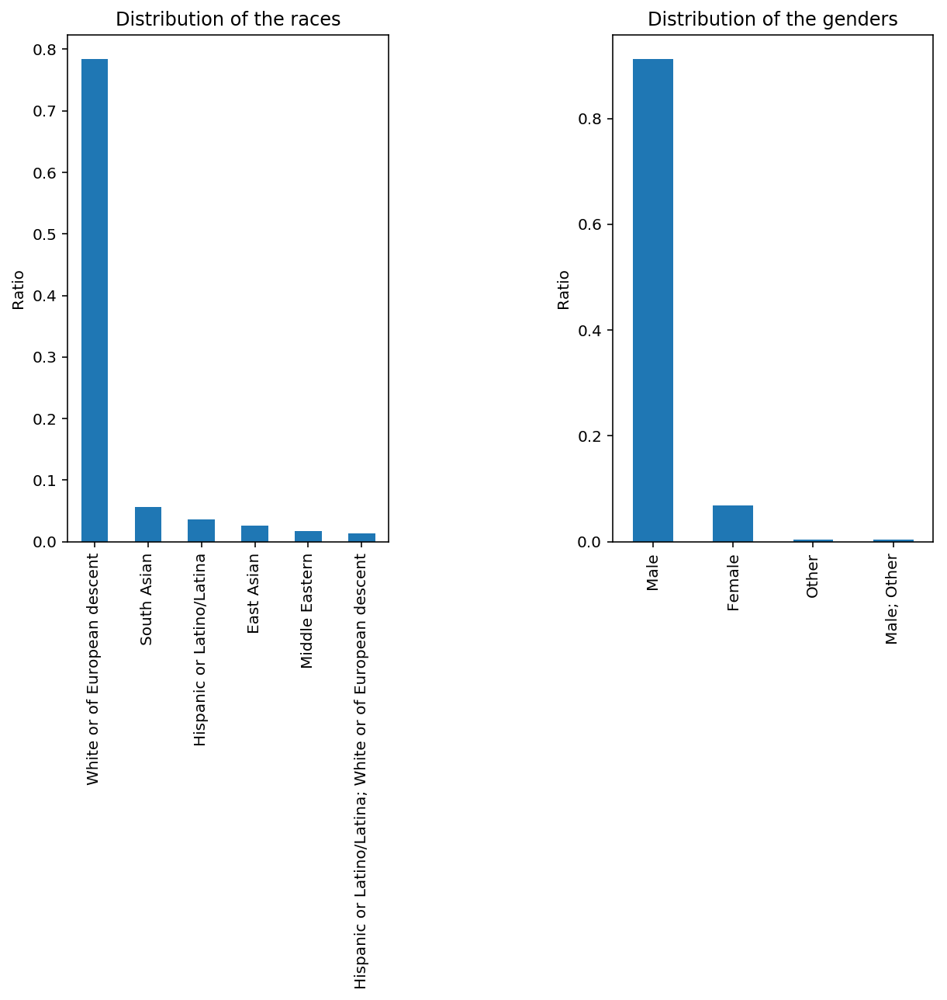

In [17]:
f, (race, gender) = plt.subplots(nrows=1, ncols=2, figsize=(10,6))
f.subplots_adjust(wspace=0.7)

prof_stack.Race.value_counts(normalize=True)[0:6].plot(kind='bar', ax=race)
race.set_title("Distribution of the races")
race.set_ylabel("Ratio")

prof_stack.Gender.value_counts(normalize=True)[0:4].plot(kind='bar', ax=gender)
gender.set_title("Distribution of the genders")
gender.set_ylabel("Ratio")

plt.show()

With no surprise, the majority of respondents are white males.
## Education types
Another interesting thing to know is how these developers learned to code. Do the students and professionals learned the same way.

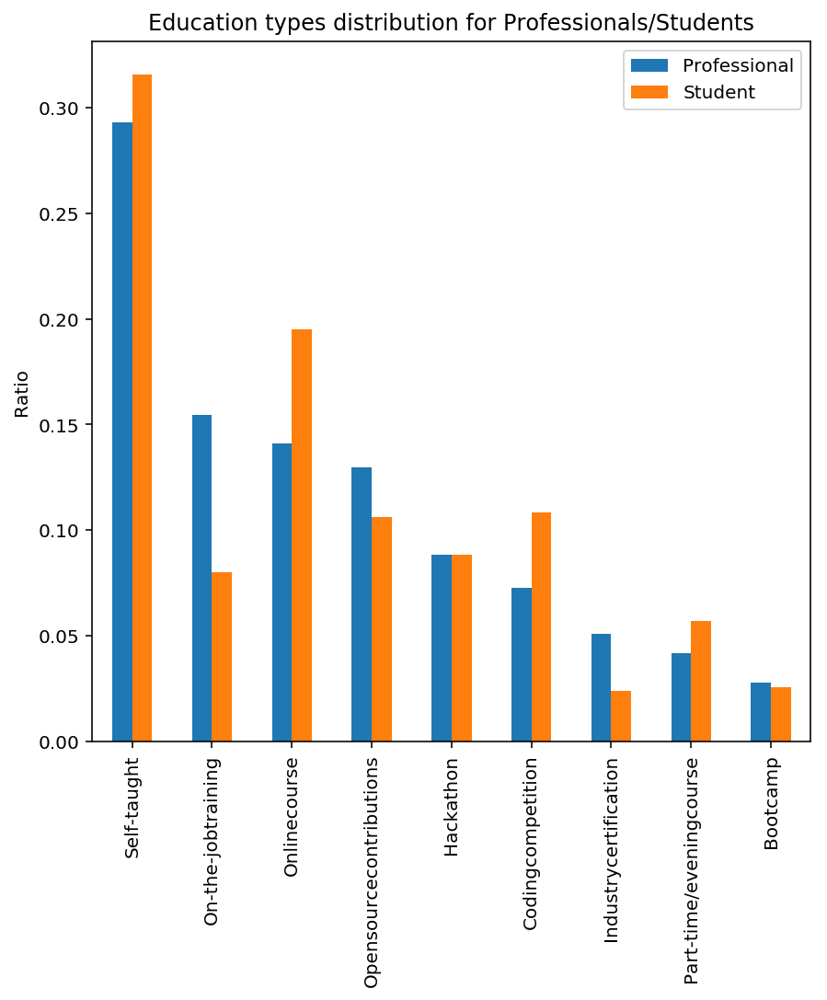

In [18]:
prof_education = pd.Series([ed for sublist in [str(educs).replace(" ", "").split(";") for educs in prof_stack['EducationTypes'].dropna()] for ed in sublist])
stud_education = pd.Series([ed for sublist in [str(educs).replace(" ", "").split(";") for educs in stud_stack['EducationTypes'].dropna()] for ed in sublist])
plot_stud_prof(prof=prof_education, stud=stud_education, title="Education types")

Again without any surprise, the distributions are quite the same, appart from the ones linked to the job/student life, for example students are more likely to learn using online courses and professional using on-the-job training.

## GIF vs JIF

Here we wanted to see the distribution of a funny feature we have access too, which is the distribution of the salary in function of the pronunciation of the term "GIF"

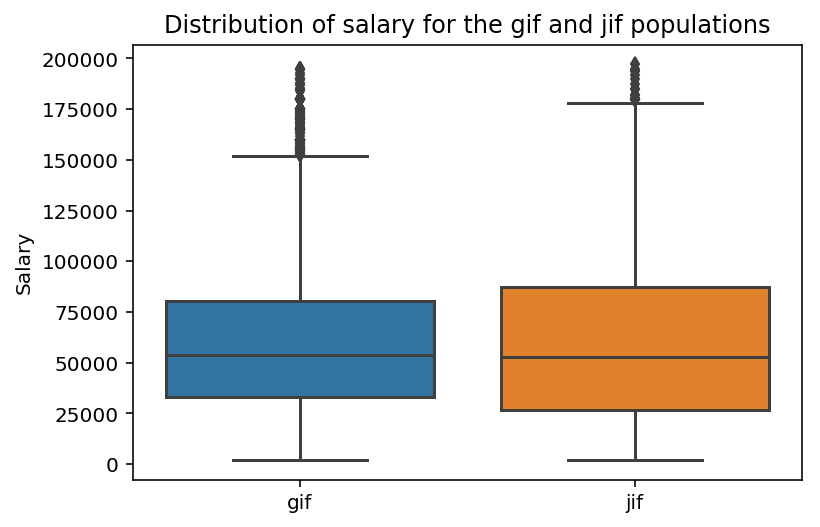

                 gif            jif
count    8765.000000    2896.000000
mean    59969.873023   60447.839240
std     37226.718306   42544.822205
min      2150.537634    2150.537634
25%     32954.545455   26881.720430
50%     53593.548387   53030.303030
75%     80645.161290   87500.000000
max    195000.000000  197000.000000


In [19]:
gif_df = stack[["PronounceGIF", "Salary"]].dropna(how='any')
gif_df = gif_df.set_index("PronounceGIF")
g_df = gif_df.loc['With a hard "g," like "gift"'].Salary.values
j_df = gif_df.loc['With a soft "g," like "jiff"'].Salary.values
comparing_df = pd.DataFrame()
comparing_df['gif'] = pd.Series(g_df)

# We fill the empty values
filling = np.empty((6081))
filling[:] = np.nan
to_add = np.append(j_df, filling)
comparing_df['jif'] = pd.Series(to_add)

# Let's check it out
plot = sns.boxplot(data=comparing_df, orient="v",)
plt.ylabel("Salary")
plt.title("Distribution of salary for the gif and jif populations")
plt.show()

print(comparing_df.describe())

As we can quickly see, there is not much difference inbetween the gif people and the jif people in terms of salary.

# Recommender system

In this section we created a recommender system to help recruiters find the candidates they are looking for. The idea is to create a network using the individuals as nodes and their similarity as the weights of the edges. Recruiters can ask for certain skills/education/locations and we will show them the closest entities to their request.

In [20]:
#Keep important features
important_features_prof = ['ProgramHobby', 'Country', 'University', 'FormalEducation', 'MajorUndergrad', 'CompanyType'
                           ,'YearsCodedJob', 'YearsProgram', 'DeveloperType', 'CareerSatisfaction', 'JobSatisfaction', 'Overpaid'
                           , 'HaveWorkedLanguage', 'WantWorkLanguage']


important_features_stud = ['ProgramHobby', 'Country', 'University', 'FormalEducation', 'YearsProgram','WorkStart',
                            'HaveWorkedLanguage', 'WantWorkLanguage', 'AuditoryEnvironment']

final_prof_stack = prof_stack[important_features_prof].copy()
final_stud_stack = stud_stack[important_features_stud].copy()

We first compute the k-nearest neighbors of each individual in our dataset and plot them on the corresponding graph. 

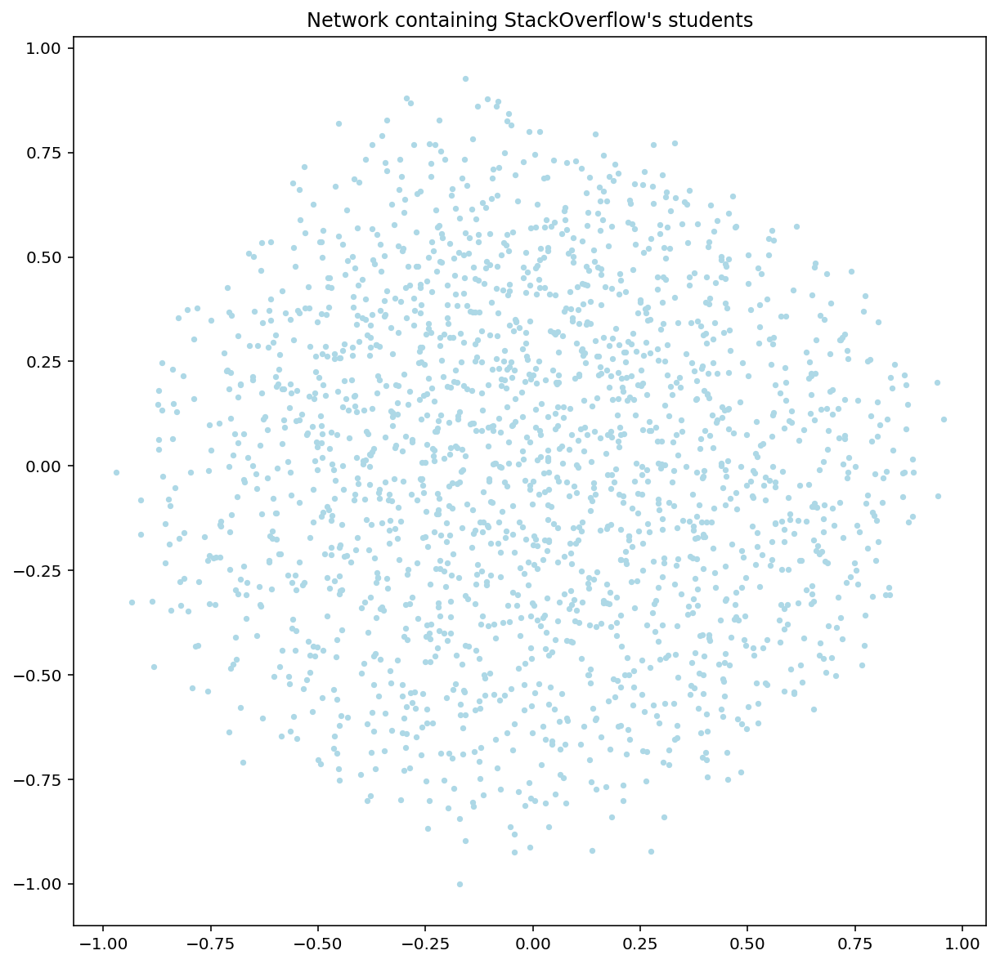

In [21]:
# Let's take a  look at the students network
preprocessed_dfs_stud = preprocessed(final_stud_stack, ["HaveWorkedLanguage", "WantWorkLanguage"],'WantWorkLanguage', False)
G_stud, pos_stud = draw_graph(compute_knn_graph(preprocessed_dfs_stud[0]), "Network containing StackOverflow's students")

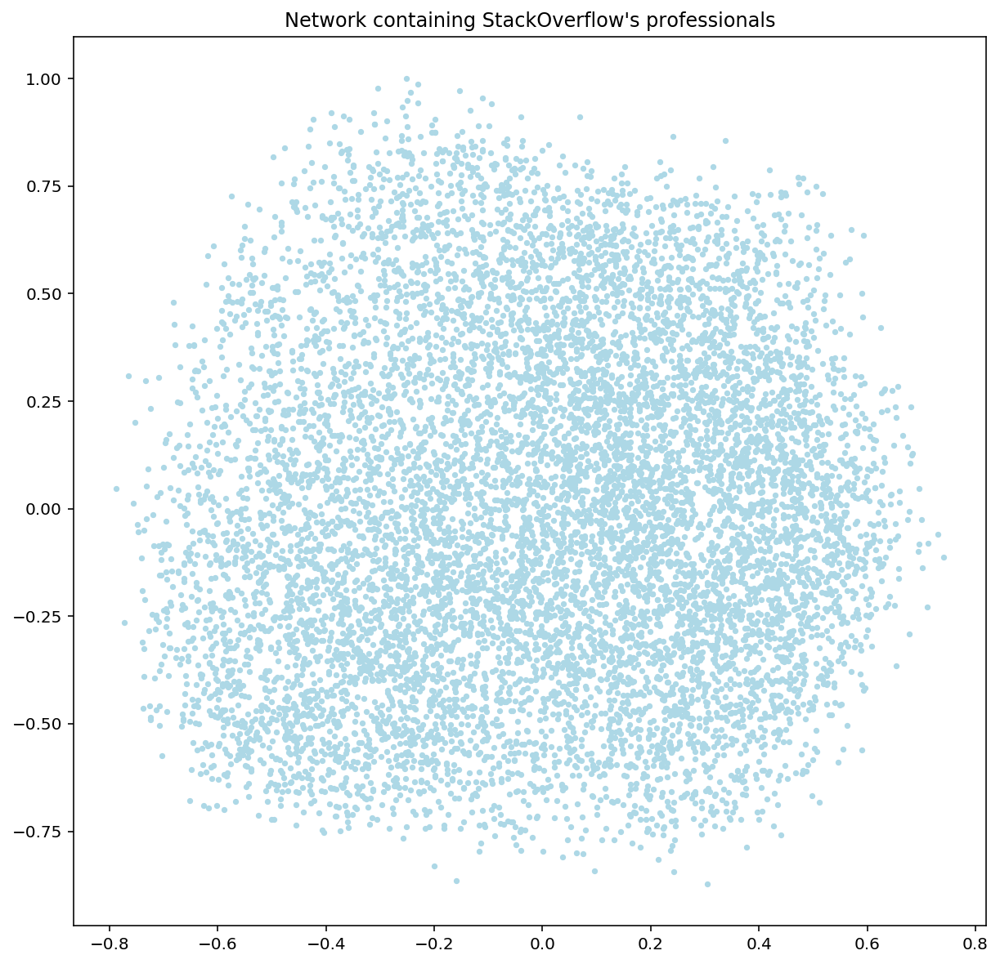

In [22]:
# Now, onto the professionals network
preprocessed_dfs_prof = preprocessed(final_prof_stack, ["HaveWorkedLanguage", "WantWorkLanguage", 'DeveloperType'],'WantWorkLanguage', True)
G_prof, pos_prof = draw_graph(compute_knn_graph(preprocessed_dfs_prof[0]), "Network containing StackOverflow's professionals")

As we have less students than professionals we can see that the network with students is more sparse.

Afterwards, we wanted to see the patterns we could find in our network due to the important features we declared above.

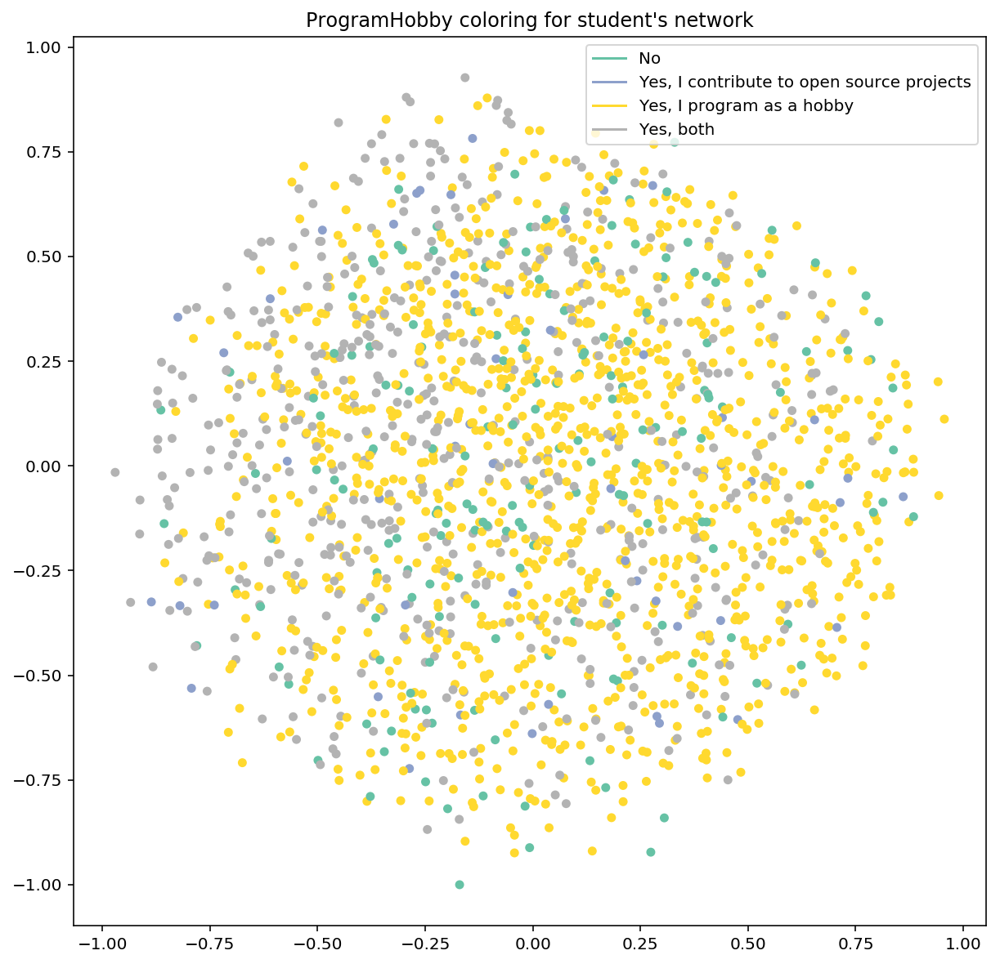

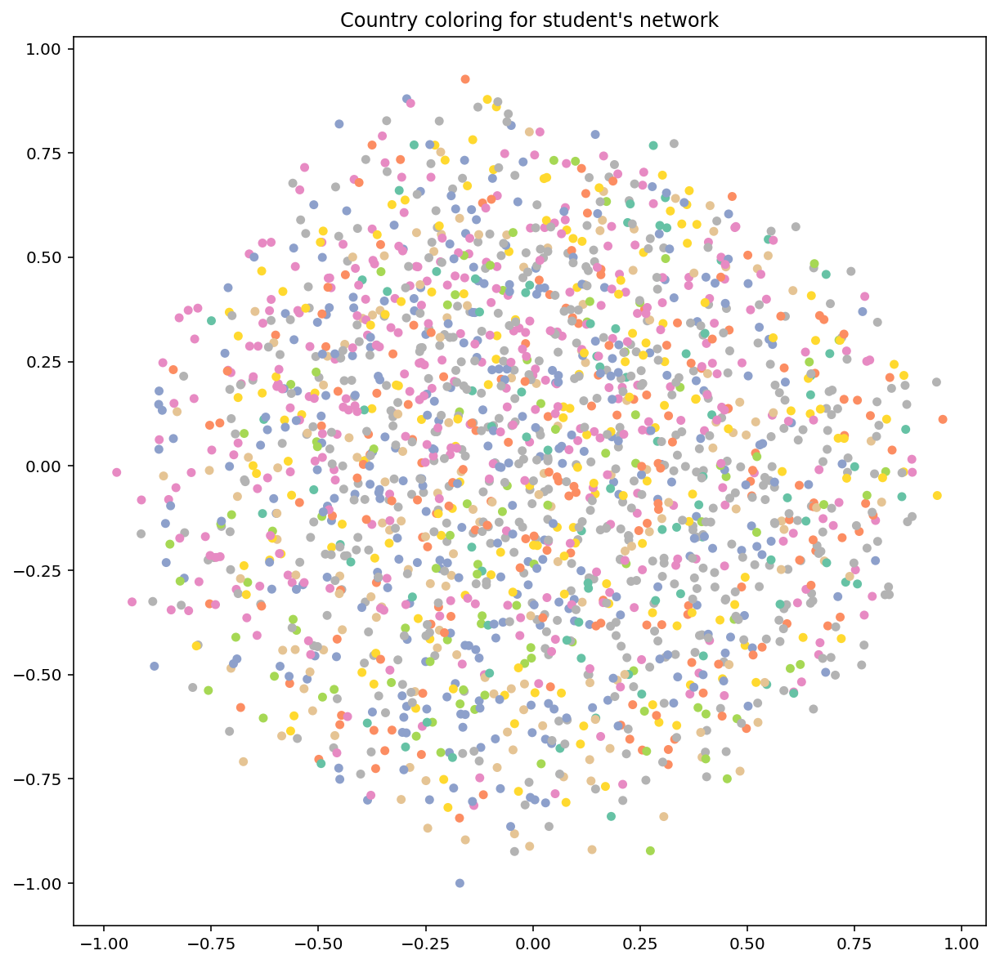

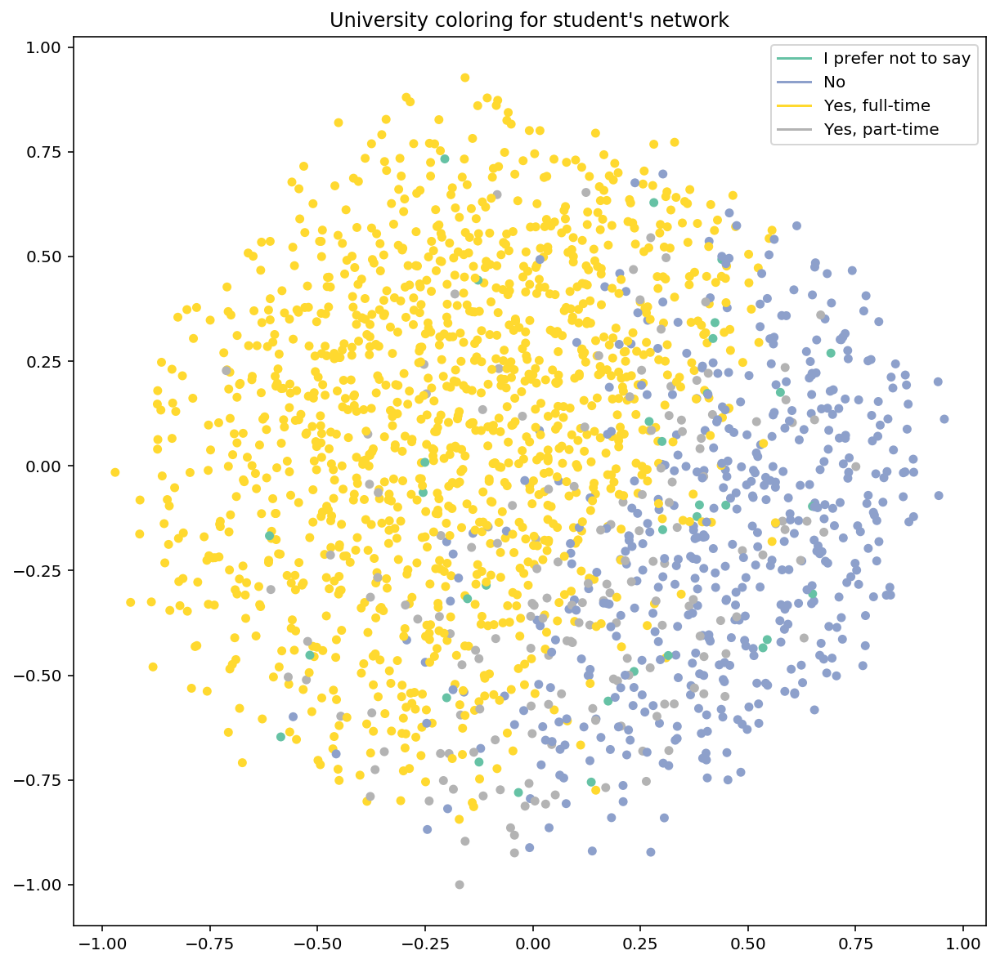

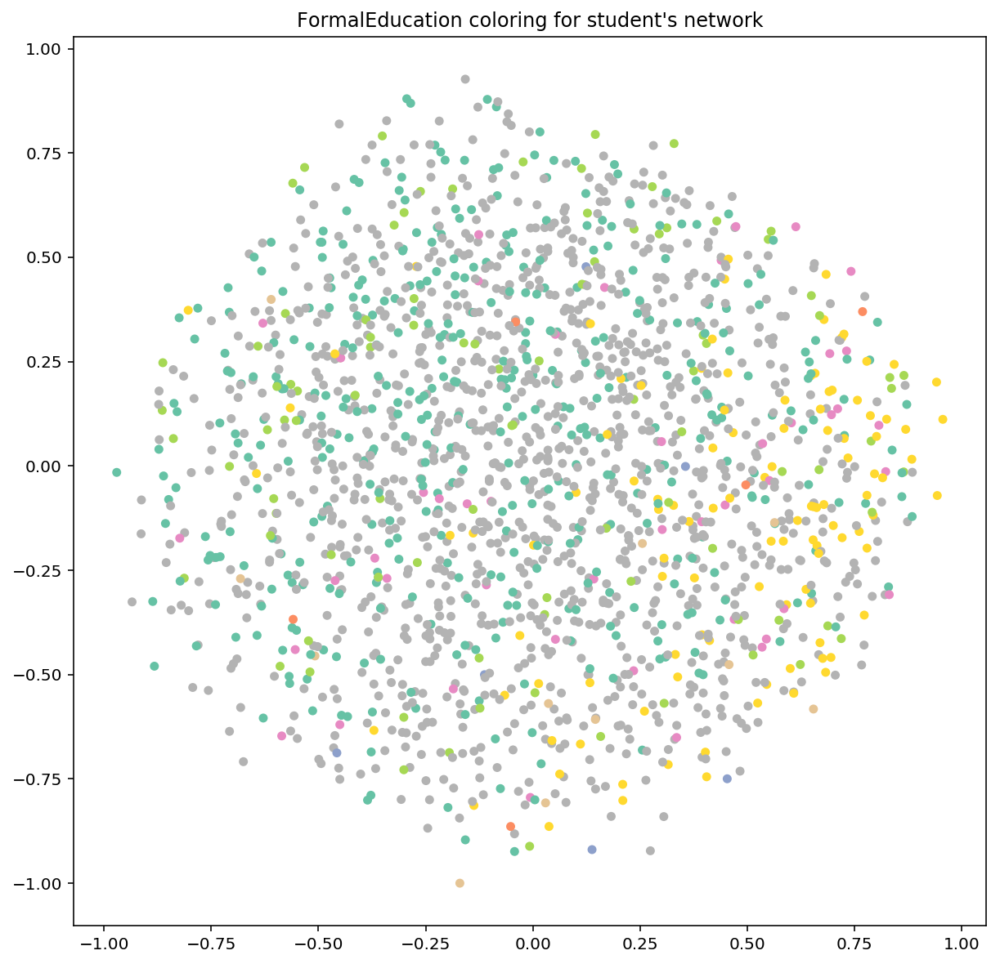

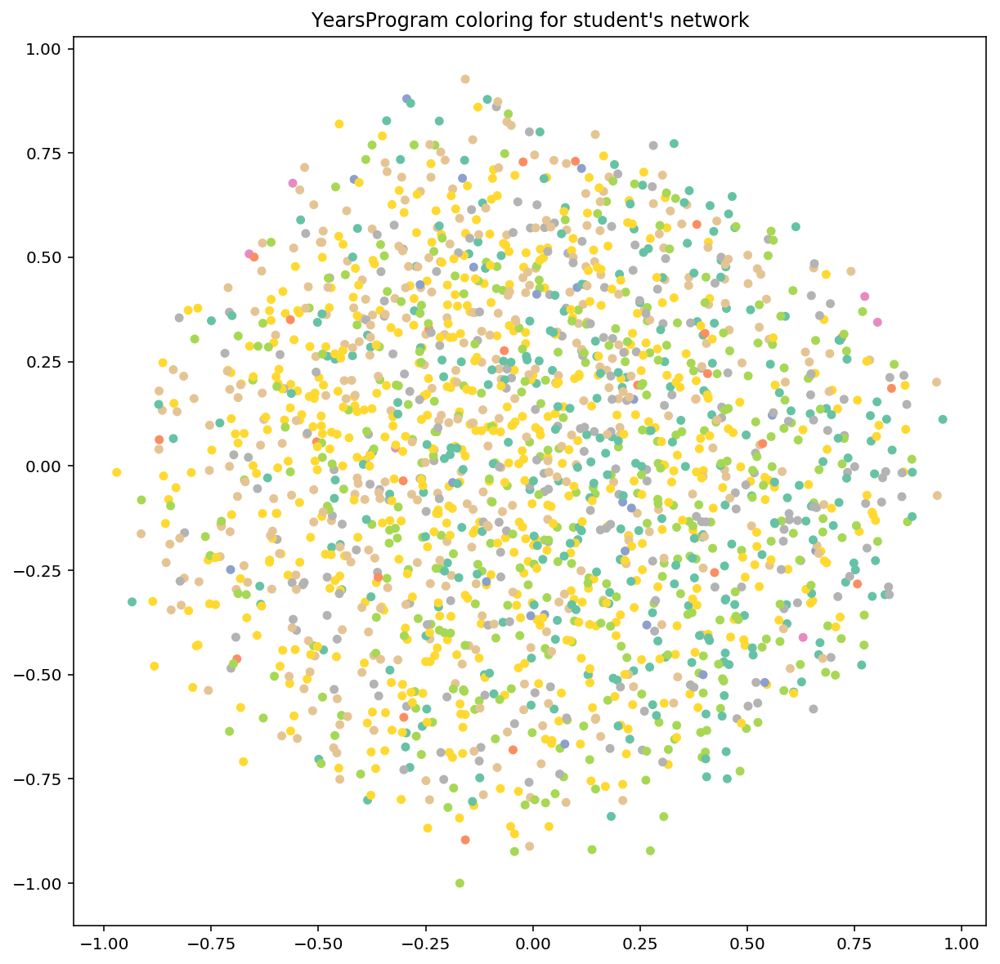

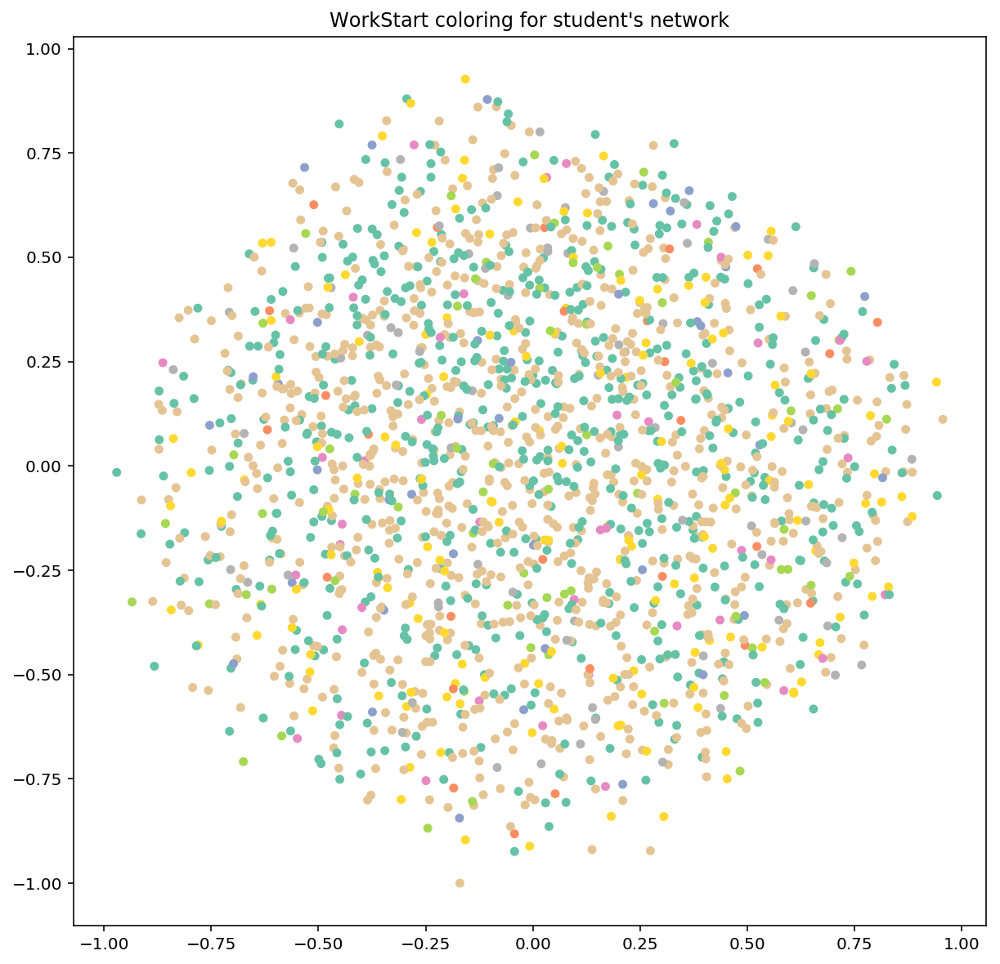

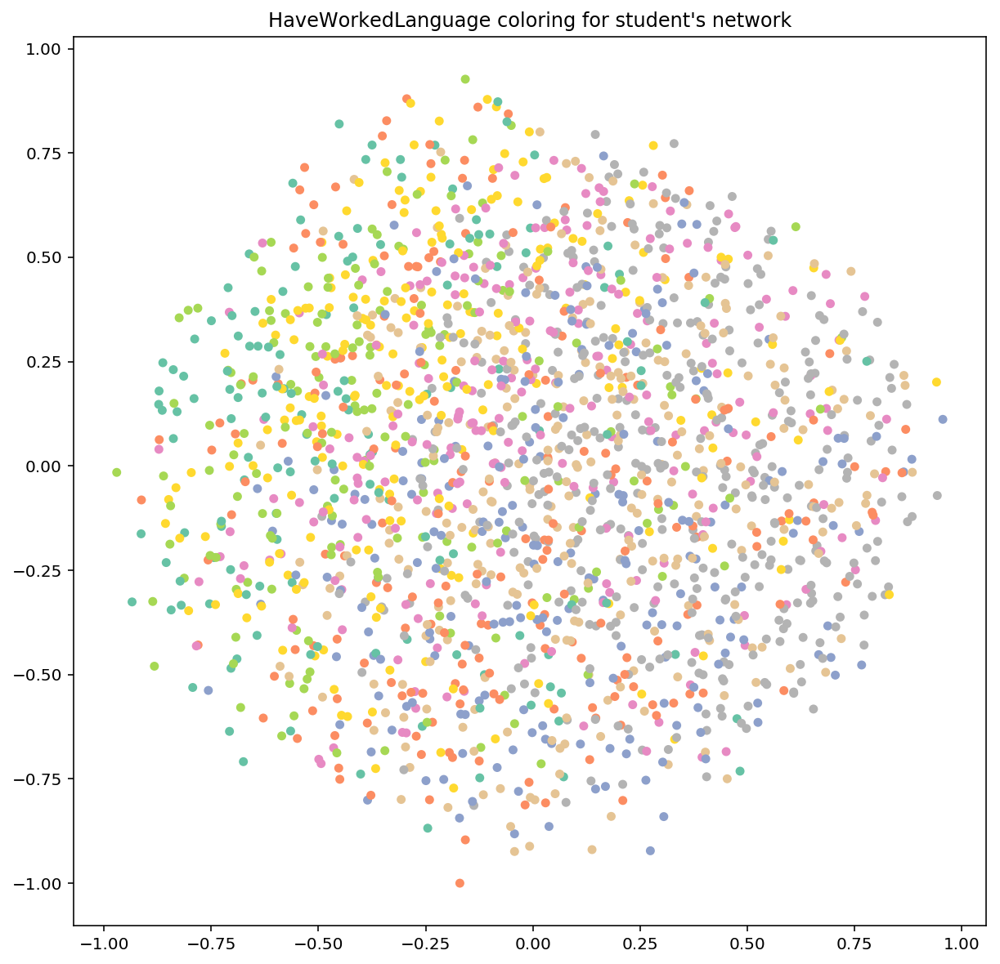

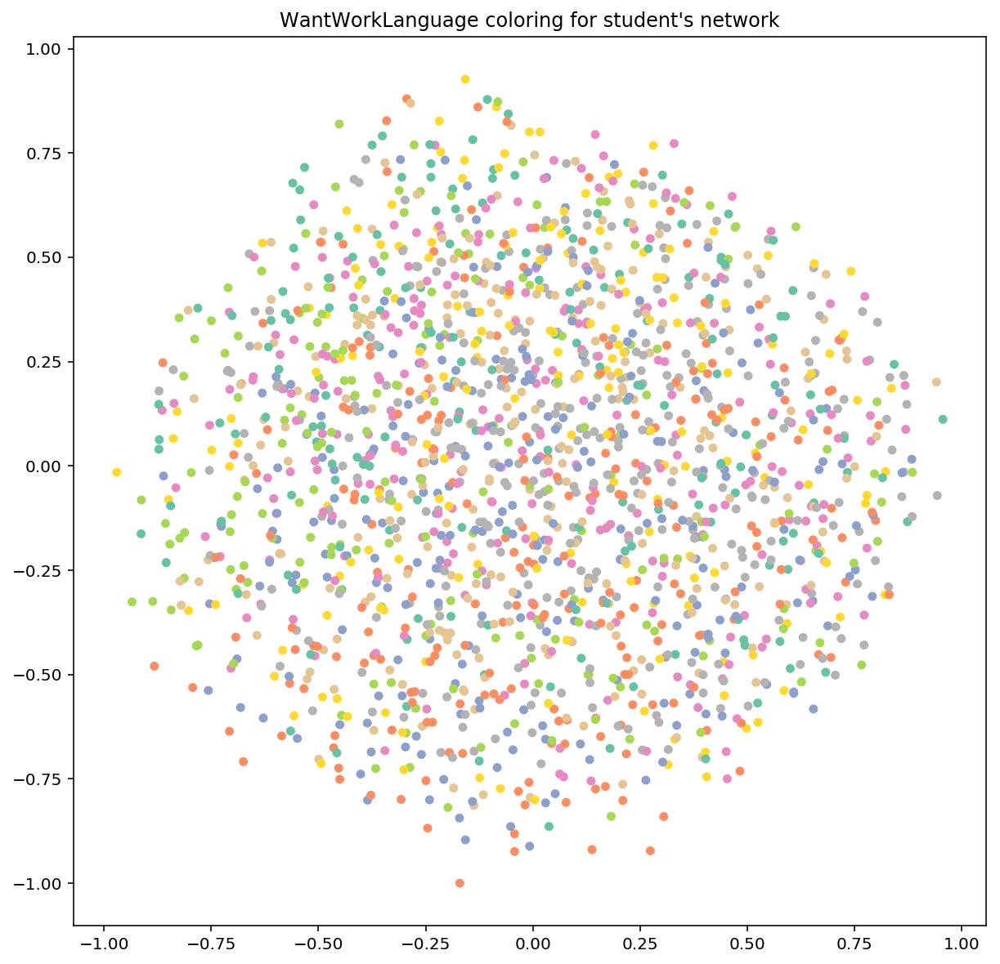

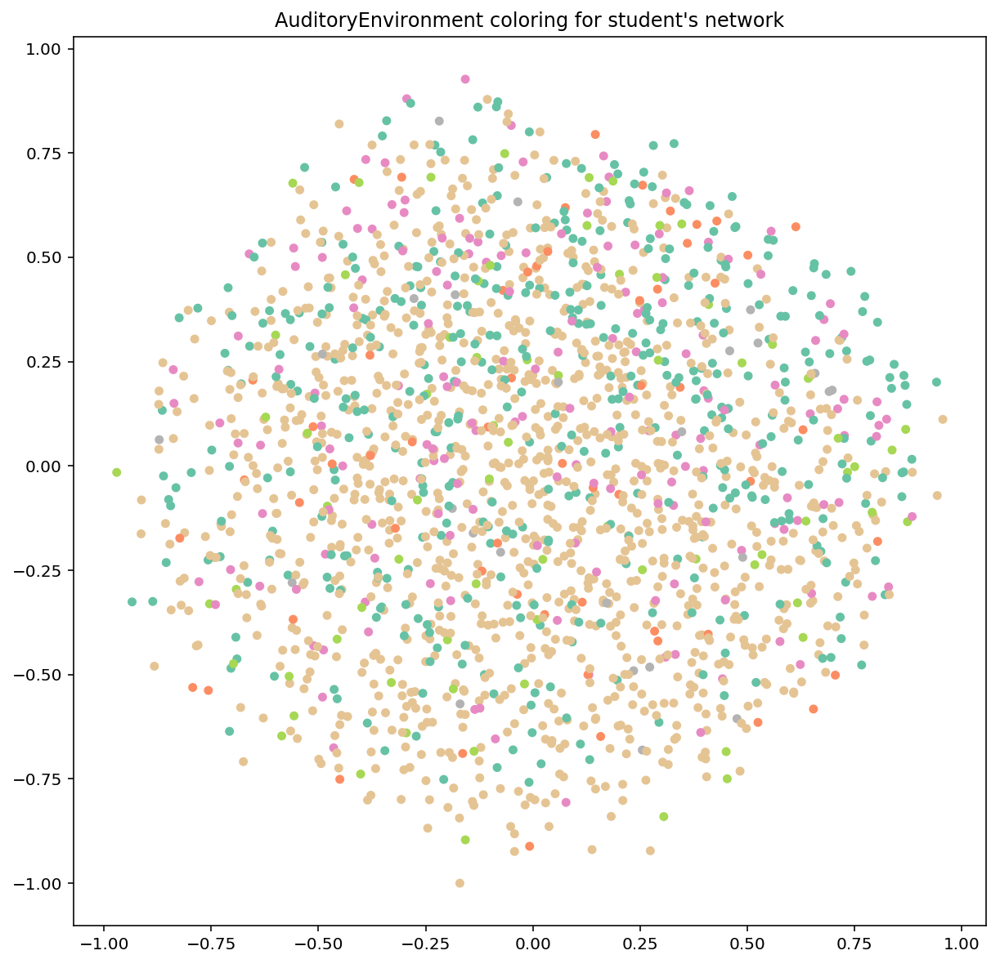

In [23]:
map_stud, df_encode_stud = encode_label(preprocessed_dfs_stud[1], important_features_stud)
map_prof, df_encode_prof = encode_label(preprocessed_dfs_prof[1], important_features_prof)

# A few features for the student's network
draw_features(important_features_stud, df_encode_stud, map_stud, G_stud, pos_stud, "student's")

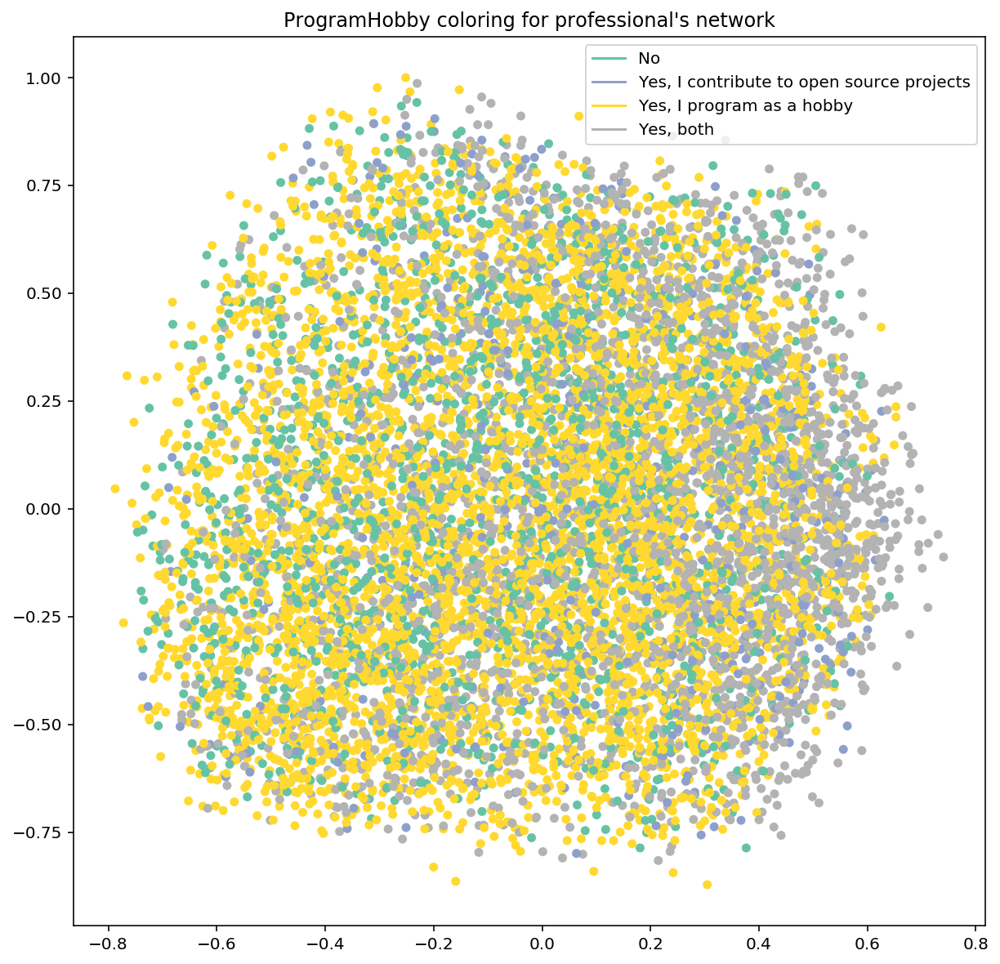

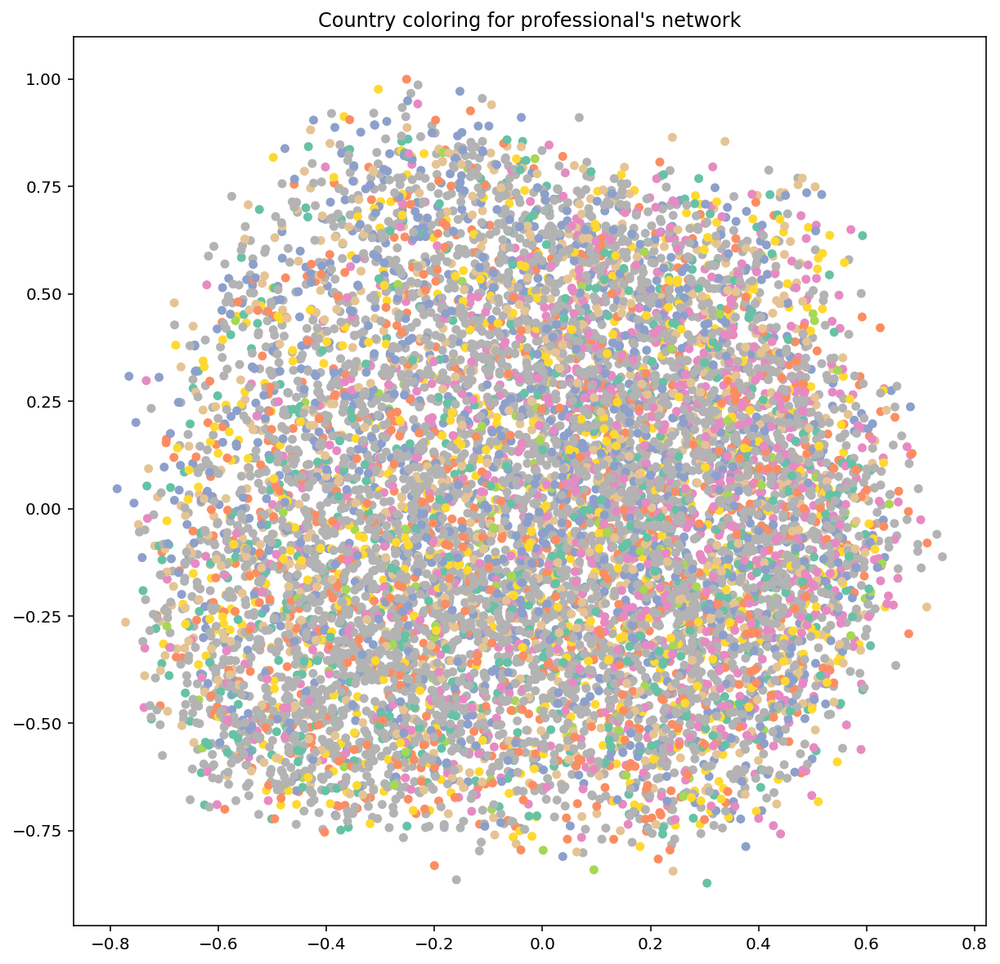

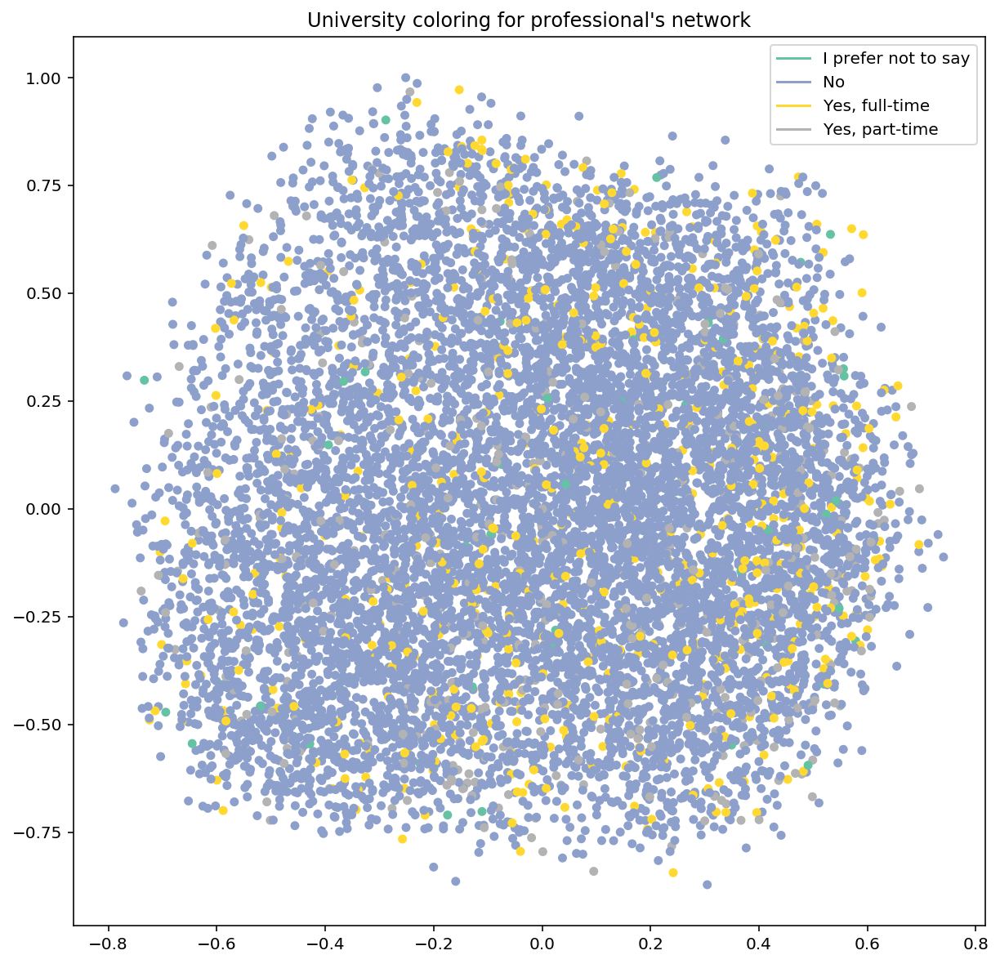

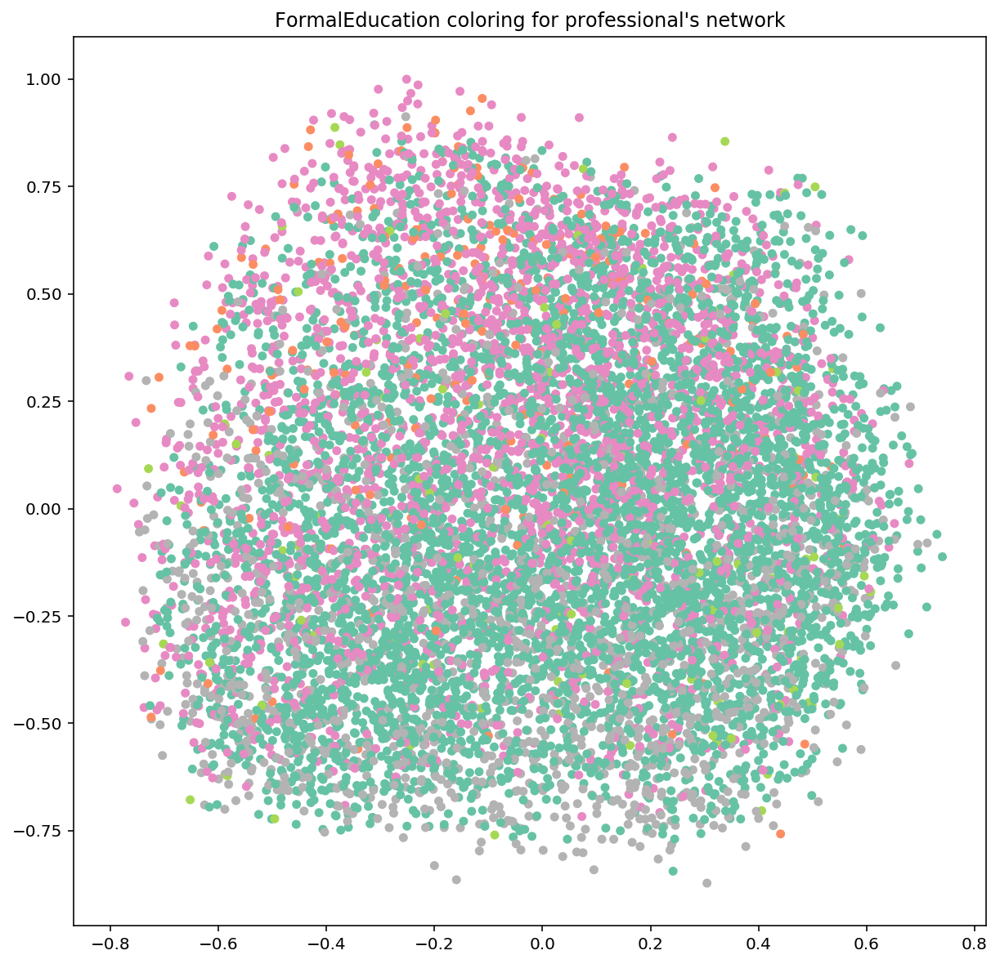

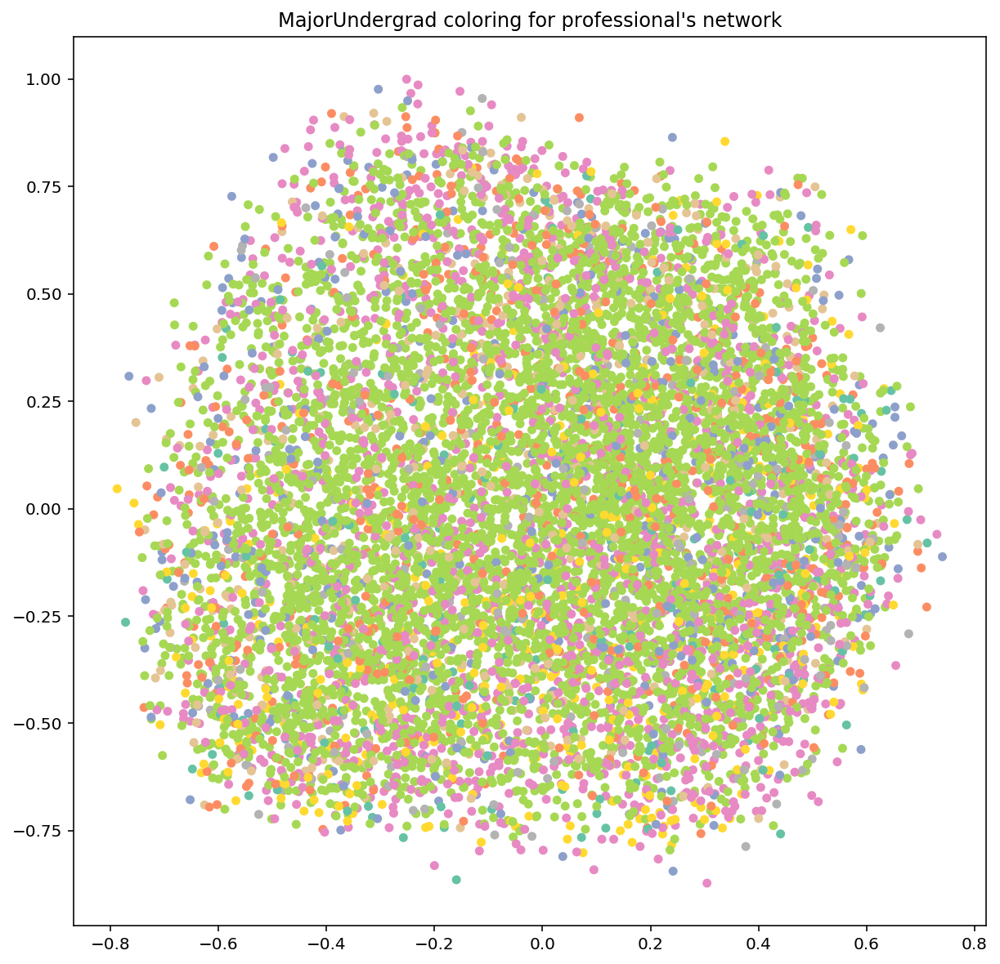

...

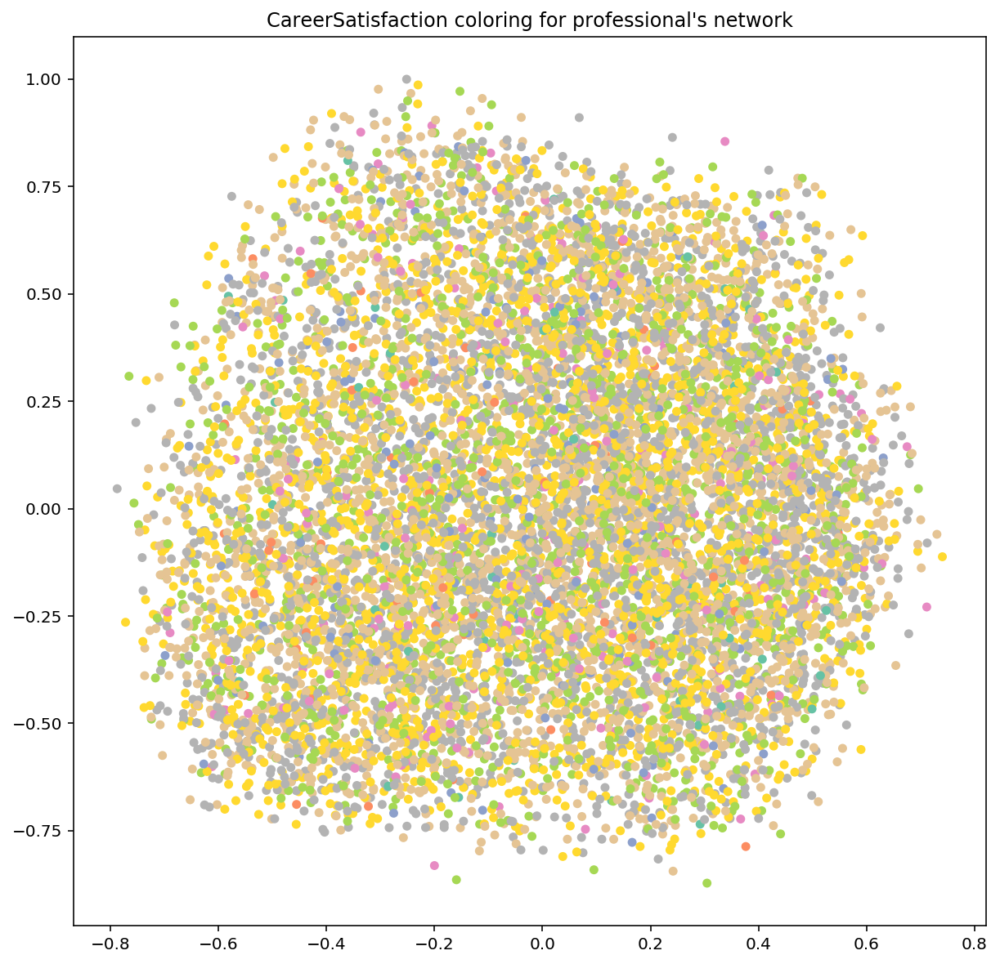

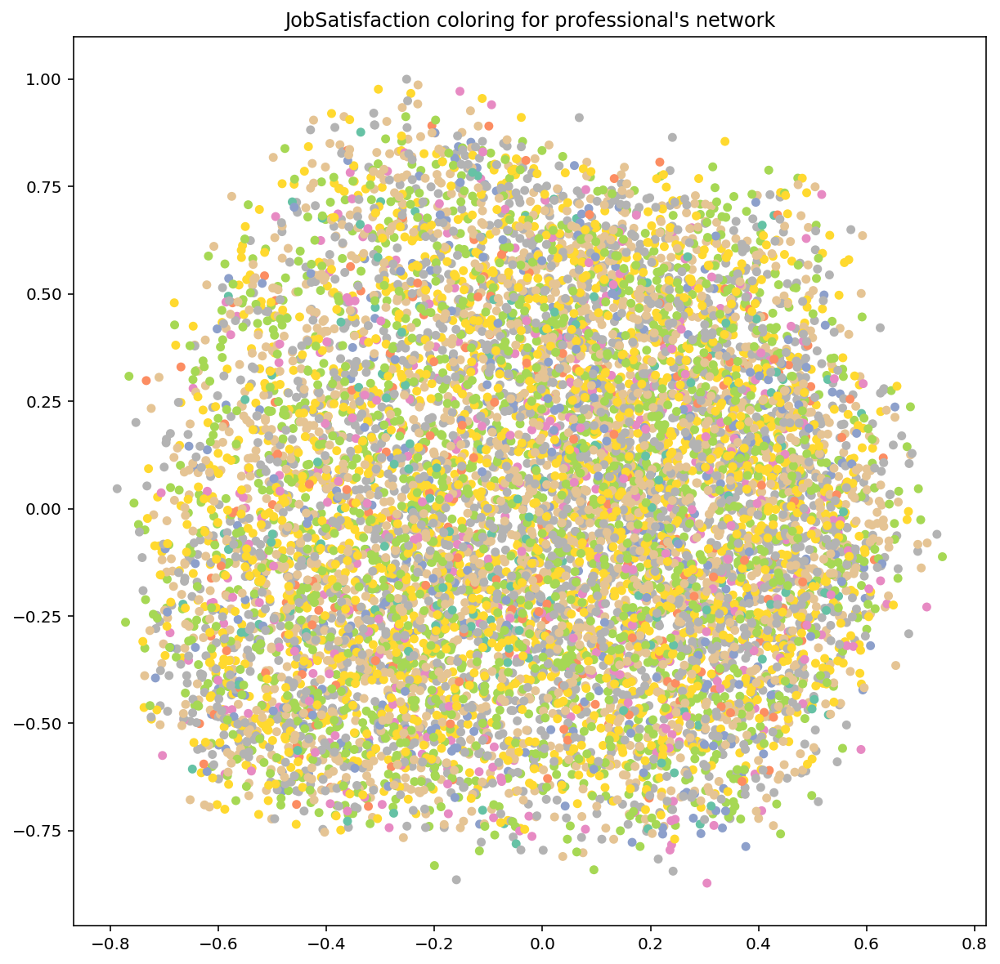

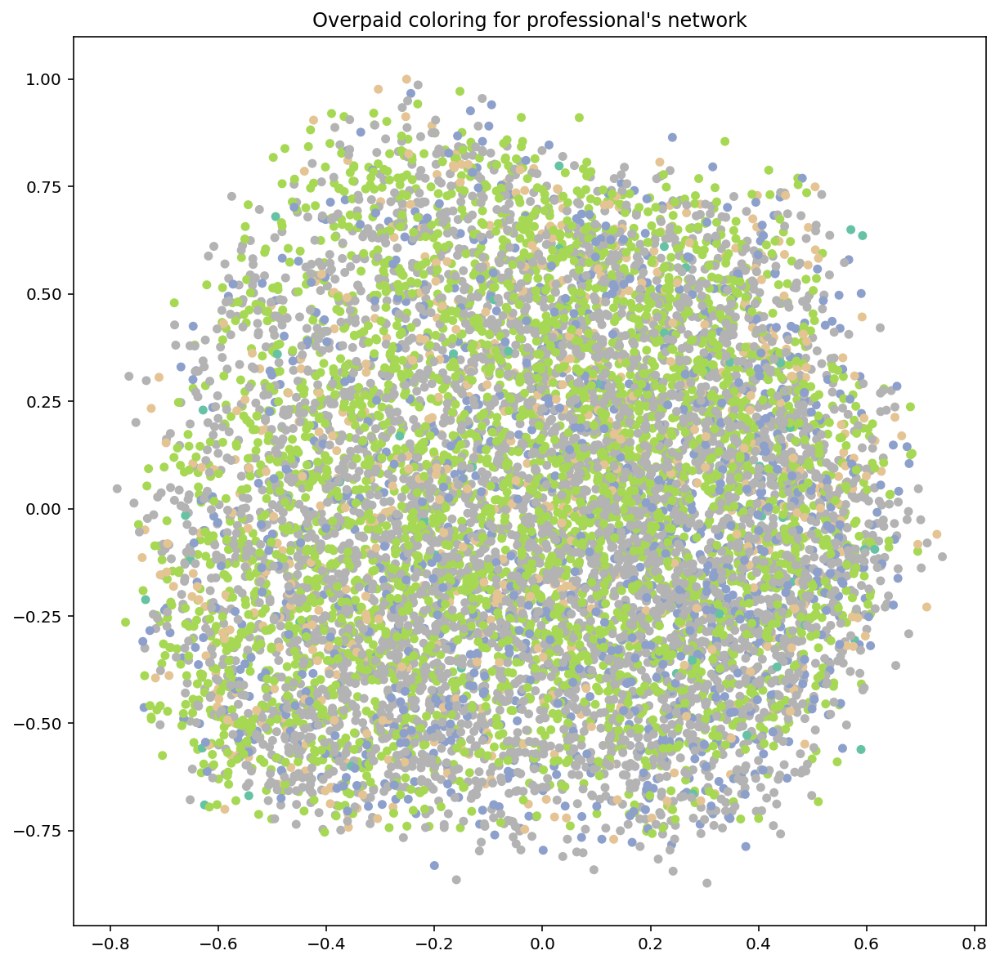

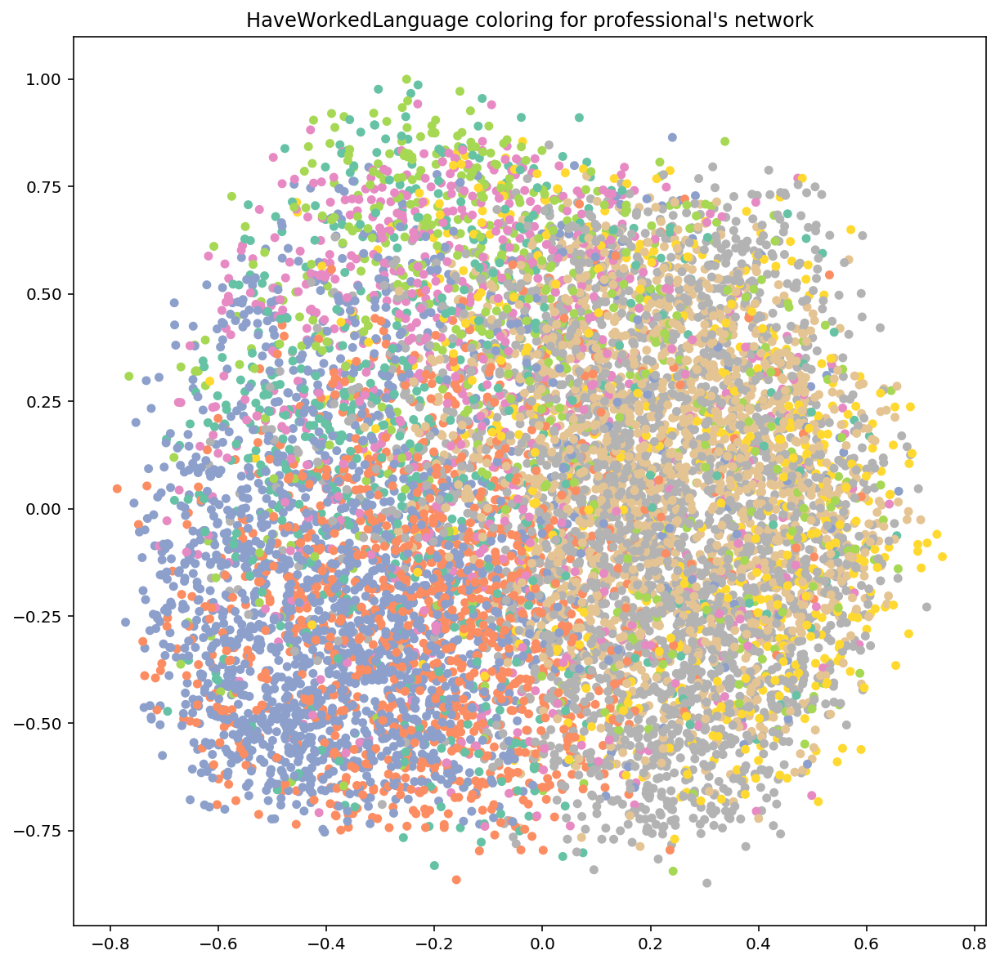

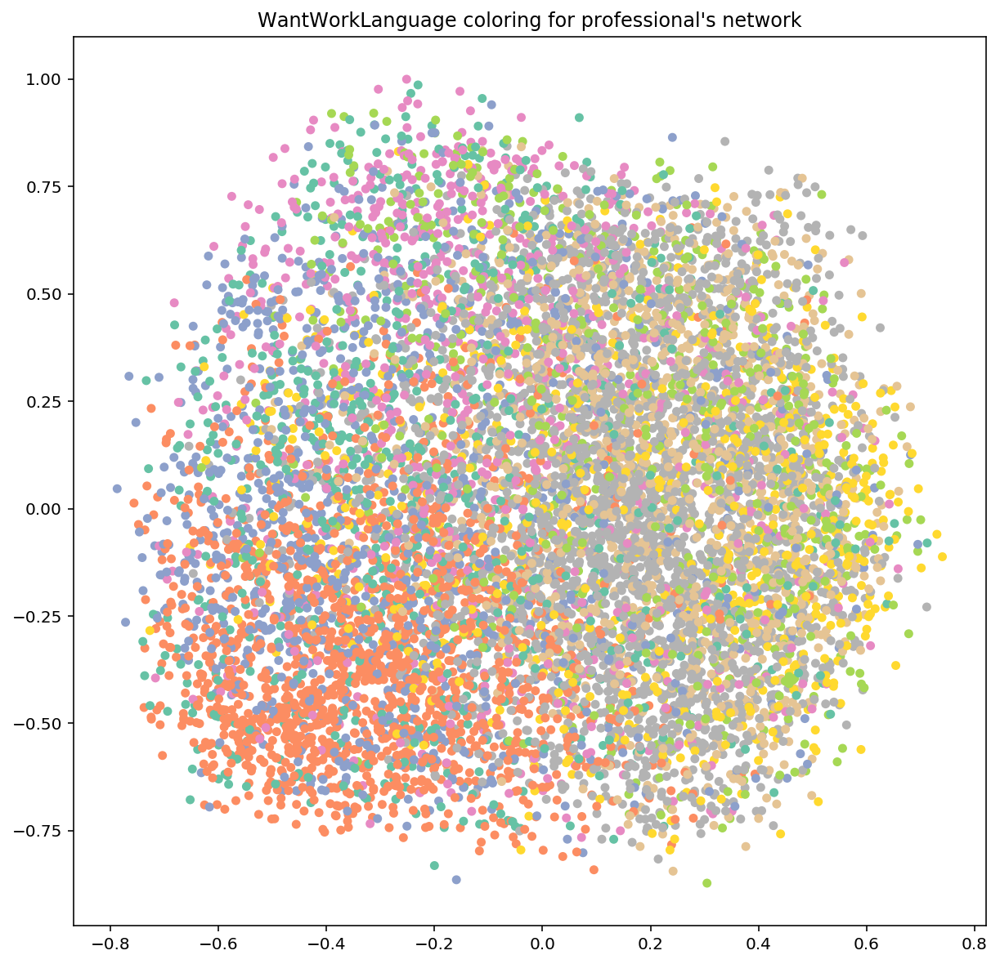

In [24]:
# A few features for the professional's network
draw_features(important_features_prof, df_encode_prof, map_prof, G_prof, pos_prof, "professional's")

As we can see, coloring the most important features creates clusters that we can directly see, which is to be expected.

# Predict

In this last section we show an example of a prediction on a given request of a recruiter, both in the students' space and in the professionnals' space. Since we use a one-hot encoder, omitting one answer of these questions is not a problem for the recommender system.

## Student

Here is the request of the students' recruiter:
- Do you program as a hobby or contribute to open source projects?: **Yes, both**
- In which country do you currently live?: **France**
- Are you currently enrolled in a formal, degree-granting college or university program?: **No**
- Which of the following best describes the highest level of formal education that you've completed?: **Secondary school**
- How long has it been since you first learned how to program?: **2 to 3 years**
- Suppose you could choose your own working hours for an 8-hour day. What time would you start work for the day? Please adjust the slider to the hour nearest your ideal start time. The box next to the slider will display your selection using a 24-hour clock: **10:00 AM**
- Which of the following languages have you done extensive development work in over the past year, and which do you want to work in over the next year?: **C#, Java**
- Which of the following languages have you done extensive development work in over the past year, and which do you want to work in over the next year?: **C++, Python**
- Suppose you're about to start a few hours of coding and have complete control over your auditory environment (music, background noise, etc.). What would you do?: **Turn on some music**

In [25]:
final_stud_stack.loc[final_stud_stack.shape[0]] = ['Yes, both', 'France', 'No', 'Secondary school', '2 to 3 years', '10:00 AM', 'C#, Java',
                                                  'C++, Python', 'Turn on some music']
predict_dfs_stud = preprocessed(final_stud_stack, ["HaveWorkedLanguage", "WantWorkLanguage"],
                                          'WantWorkLanguage', False)
knn_stud = compute_knn_graph(predict_dfs_stud[0])

best_predict_stud = np.argsort(knn_stud.toarray()[-1])[::-1][1:6]
size_stud = preprocessed_dfs_stud[1].shape[0]
predict_dfs_stud[1].iloc[[size_stud-1] + list(best_predict_stud), :]

,ProgramHobby,Country,University,FormalEducation,YearsProgram,WorkStart,HaveWorkedLanguage,WantWorkLanguage,AuditoryEnvironment
Respondent,,,,,,,,,
51377,"Yes, I program as a hobby",Germany,"Yes, full-time",Secondary school,6 to 7 years,6:00 AM,C; C#; Java; Python; SQL; Swift,C++; Go; Java; JavaScript; Python; SQL; Swift,Turn on some music
50258,"Yes, I program as a hobby",United Kingdom,No,Secondary school,2 to 3 years,10:00 AM,Python,Java,Turn on some music
28610,"Yes, both",Germany,No,Secondary school,1 to 2 years,10:00 AM,JavaScript,JavaScript,Turn on some music
33330,"Yes, I program as a hobby",Canada,No,Secondary school,2 to 3 years,10:00 AM,C; C++,C; C++,Turn on some music
1397,"Yes, I program as a hobby",Spain,No,Secondary school,2 to 3 years,10:00 AM,C; C++; C#,Assembly,Turn on some music
27641,"Yes, I program as a hobby",China,No,Secondary school,2 to 3 years,9:00 AM,Python,C#; Python,Turn on some music


All of these people are the ones recommended through our recommender system, as we can see they all match quite a lot of the answers from the recruiter, which is what we wanted, it works ! Let's take a look at the network representation of the recommendations.

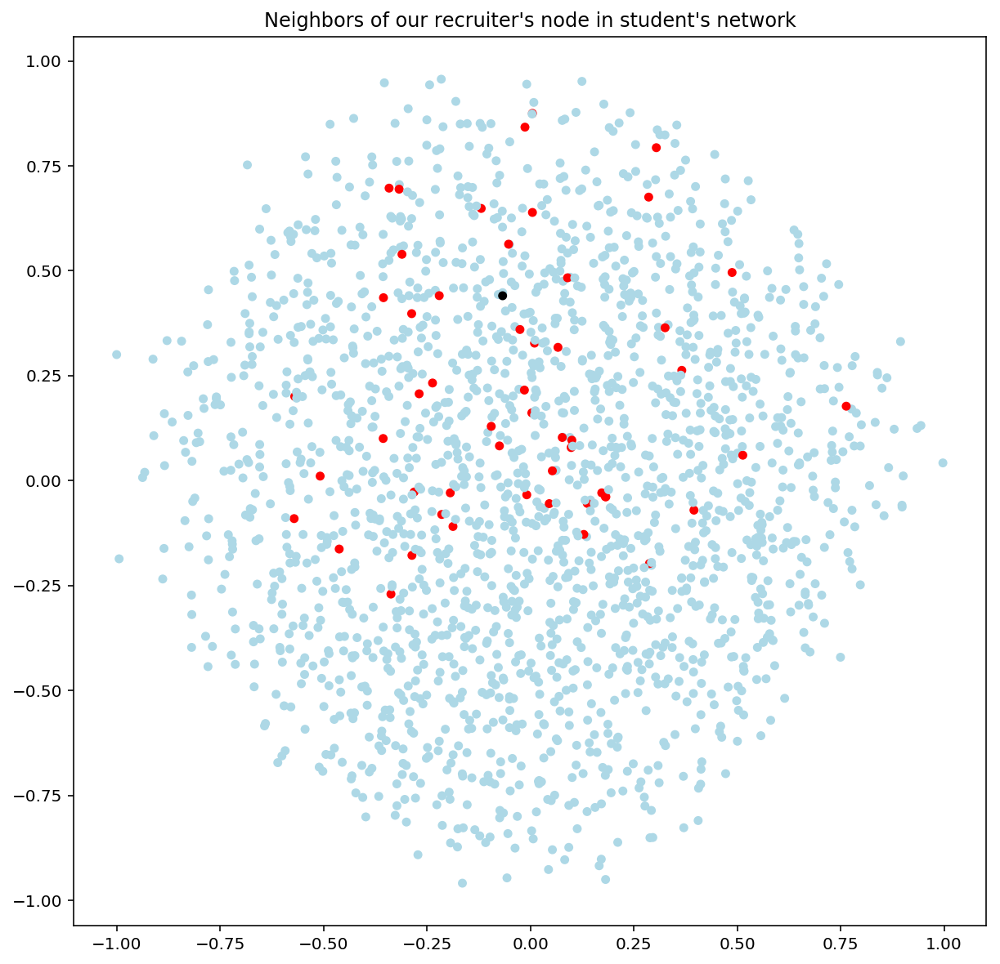

In [26]:
G_stud = nx.from_scipy_sparse_matrix(knn_stud, edge_attribute='similarity')
pos_stud = nx.spring_layout(G_stud)
draw_neighbors(G_stud, pos_stud, size_stud-1, "Neighbors of our recruiter's node in student's network")

In black is the node formed by the recruiter and his answers to the questions, then in red we can see the recommendations that we will provide him with while the rest of the nodes are in blue. We can see that the nodes are not that far from one another, even if they seem so, this is due to the fact that the real network is embedded in about 15 dimensions, and is impossible to see for the human eye. However we can confirm through the KNN algorithm that they are in fact the closest nodes to our recruiter's answers.

## Professional 

Here is the request of the professionals' recruiter:
- Do you program as a hobby or contribute to open source projects?: **Yes, both**
- In which country do you currently live?: **United Kingdom**
- Are you currently enrolled in a formal, degree-granting college or university program?: **No**
- Which of the following best describes the highest level of formal education that you've completed?: **Bachelor's degree**
- Which of the following best describes your main field of study (aka 'major') in college or university/for your undergraduate studies?: **Computer science or software engineering**
- Which of the following best describes the type of company or organization you work for?: **Publicly-traded corporation**
- For how many years have you coded as part of your job?: **20 or more years**
- How long has it been since you first learned how to program?: **20 or more years**
- Which of the following best describe you?: **Other**
- Career satisfaction rating: **8.0**
- Job satisfaction rating: **9.0**
- Compared to your estimate of your own market value, do you think you are…?: **Neither underpaid nor overpaid**
- Which of the following languages have you done extensive development work in over the past year, and which do you want to work in over the next year?: **Java, PHP, Python**
- Which of the following languages have you done extensive development work in over the past year, and which do you want to work in over the next year?: **C, Python, Rust**

In [27]:
final_prof_stack.loc[final_prof_stack.shape[0]] = ['Yes, both', 'United Kingdom', 'No', "Bachelor's degree", 'Computer science or software engineering', 
                                                   'Publicly-traded corporation', '20 or more years', '20 or more years', 'Other', 
                                                   8.0, 9.0, 'Neither underpaid nor overpaid', 'Java; PHP; Python', 
                                                   'C; Python; Rust']

predict_dfs_prof = preprocessed(final_prof_stack, ["HaveWorkedLanguage", "WantWorkLanguage", "DeveloperType"],
                                          'WantWorkLanguage', True)

knn_prof = compute_knn_graph(predict_dfs_prof[0])
best_predict_prof = np.argsort(knn_prof.toarray()[-1])[::-1][1:6]

size_prof = preprocessed_dfs_prof[1].shape[0]
predict_dfs_prof[1].iloc[[size_prof-1] + list(best_predict_prof), :]

,ProgramHobby,Country,University,FormalEducation,MajorUndergrad,CompanyType,YearsCodedJob,YearsProgram,DeveloperType,CareerSatisfaction,JobSatisfaction,Overpaid,HaveWorkedLanguage,WantWorkLanguage
Respondent,,,,,,,,,,,,,,
51391,"Yes, I program as a hobby",United States,No,Bachelor's degree,Computer science or software engineering,"Sole proprietorship or partnership, not in sta...",3 to 4 years,17 to 18 years,Web developer; Mobile developer,6.0,7.0,Greatly underpaid,JavaScript; PHP; Swift,Clojure; Erlang; Haskell
3,"Yes, both",United Kingdom,No,Bachelor's degree,Computer science or software engineering,Publicly-traded corporation,20 or more years,20 or more years,Other,8.0,9.0,Neither underpaid nor overpaid,Java; PHP; Python,C; Python; Rust
41596,"Yes, both",United Kingdom,No,Master's degree,Computer science or software engineering,Publicly-traded corporation,20 or more years,20 or more years,Other,8.0,9.0,Neither underpaid nor overpaid,C++; Java; Objective-C; PHP; Python; Scala,C++; Scala
29027,"Yes, both",United Kingdom,No,Bachelor's degree,Computer science or software engineering,Publicly-traded corporation,4 to 5 years,12 to 13 years,Embedded applications/devices developer; Other,8.0,8.0,Neither underpaid nor overpaid,C; Java; JavaScript; Python,C; JavaScript; Python
46006,"Yes, both",United Kingdom,No,Bachelor's degree,Computer science or software engineering,Publicly-traded corporation,3 to 4 years,6 to 7 years,Other,7.0,7.0,Neither underpaid nor overpaid,Java; JavaScript; Python,Haskell; Java; Rust
6185,No,United States,No,Bachelor's degree,Computer science or software engineering,Publicly-traded corporation,20 or more years,20 or more years,Web developer; Systems administrator,8.0,8.0,Neither underpaid nor overpaid,Python,Python


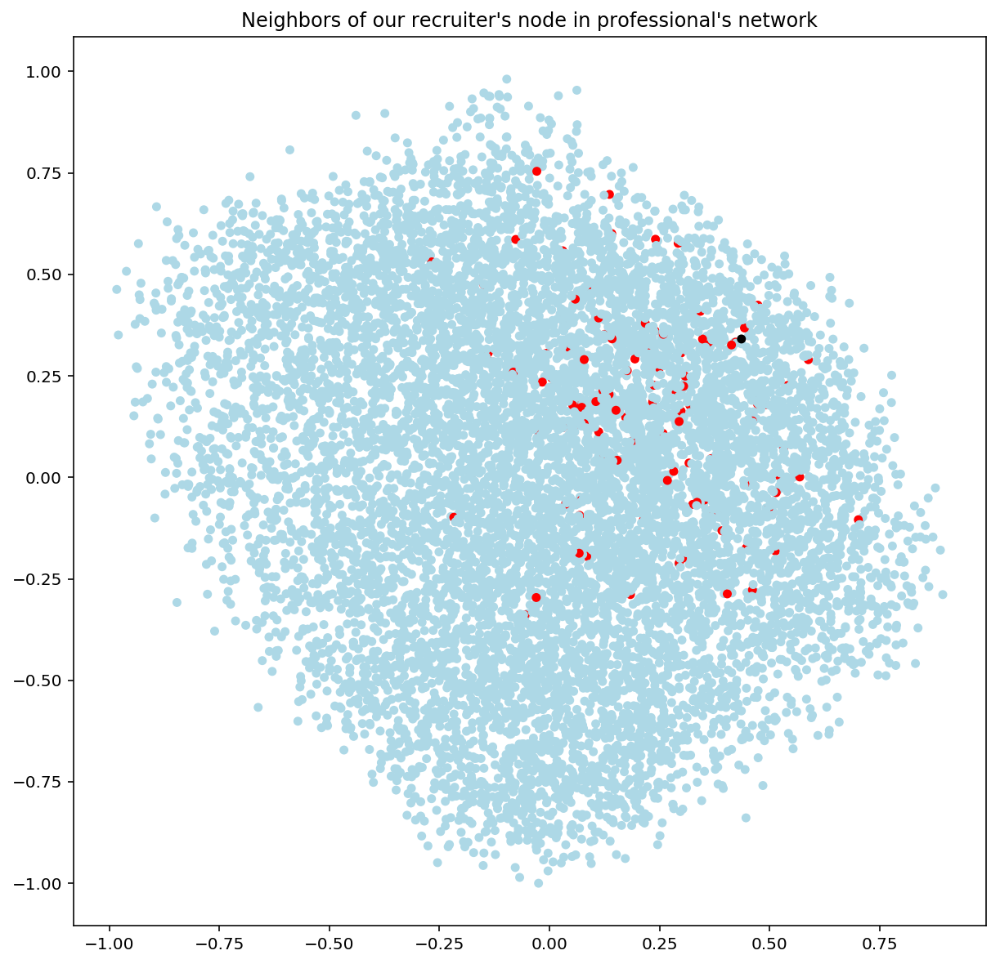

In [28]:
G_prof = nx.from_scipy_sparse_matrix(knn_prof, edge_attribute='similarity')
pos_prof = nx.spring_layout(G_prof)
draw_neighbors(G_prof, pos_prof, size_prof-1, "Neighbors of our recruiter's node in professional's network")

Once again, we can see that the system also works for professionals ! We have then created a full blown recommender system for recruiters to use, thanks to graph theory.